<a href="https://colab.research.google.com/github/ekolmagorov/FailureForecasting/blob/main/ST_UNET_VGG_SoftTrain.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

В данном ноутбуке проводятся экперименты с предложенной архитектурой на основе модели UNet и AdaIN трансформации: к каждому skip-connection тензору из части энкодера применяется оперция AdaIN, причём каждая операция добавления Skip_connection имеет свой вес $w_{i} \in [0, 1]$. При обучении веса равны 1, но добавляется dropout слой, чтобы верхнии слои при обратном распространении градиентов сильно подавляли градиенты в более глубоких слоях.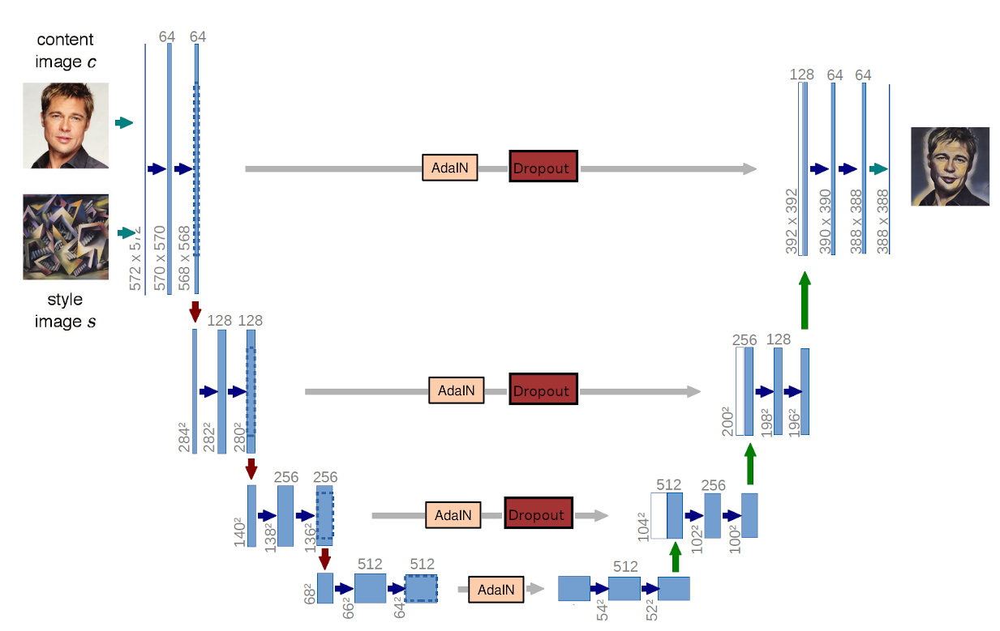 

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import random

import os
import torch 

from torchvision.models import resnet as resnet_modules
from torch.optim import Adam
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from collections import OrderedDict
from torch.utils.tensorboard import SummaryWriter
from google.colab import drive
from matplotlib.pyplot import Line2D

In [2]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Mon May 31 07:32:42 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   54C    P0    29W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
random.seed(123)
DEVICE  = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

In [4]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
% cd /content/drive/MyDrive/курсовая
#! ls

/content/drive/MyDrive/курсовая


In [6]:
#special Identity  layer thst change batchNorm in Resnet
#see arxiv.org/pdf/1701.02096.pdf - why batch norm's bad for style transfer
class Identity(nn.Module):
    def __init__(self):
        super(Identity, self).__init__()

    def forward(self, x):
        return x

In [7]:
def init_model(model_name, pretrained=False):
    '''
    Special function that return ready encoder model
    Here are realised ResNet & VGG models
    In ResNet change all BN on Identity Layer
    and add one more addition Conv and MaxPool Layer
    '''
    if model_name == 'resnet':
        resnet = torch.hub.load('pytorch/vision:v0.9.0', 'resnet18', pretrained=pretrained)
        length = len(list(resnet.children()))
        od = OrderedDict()
        for index, (name, val) in enumerate(resnet.named_children()):
            if index == length - 2:
                break
            if isinstance(val, nn.BatchNorm2d):
                val = Identity()
                
            if isinstance(val, nn.Sequential):
                for ch_name, ch_val in val.named_children():
                    if isinstance(ch_val, resnet_modules.BasicBlock):
                        ch_val.bn1 = Identity()
                        ch_val.bn2 = Identity()
                        if hasattr(ch_val, 'downsample'):
                            downsample = getattr(ch_val, 'downsample')
                            if isinstance(downsample, nn.Sequential):
                                downsample[1]= Identity()
            
            od[name] = val

        od['maxpool2'] = nn.MaxPool2d(2)
        od['conv2'] = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        od['relu2'] = nn.ReLU()
        od['maxpool3'] = nn.MaxPool2d(2)

        model = nn.Sequential(od)

        layers =  ['relu', 'layer1', 'layer2', 'layer3', 'layer4', 'relu2']
        
        channels_sizes = [(512, 512),
                          (512, 512),
                          (512, 256),
                          (256, 128),
                          (128, 64),
                          (64, 64)]

    elif model_name == 'vgg' :
        model = torch.hub.load('pytorch/vision:v0.9.0', 'vgg16', pretrained=pretrained).features
        layers = ['1', '6', '11', '18', '25']
        channels_sizes = [(512, 512),
                        (512, 512),
                        (512, 256),
                        (256, 128),
                        (128, 64)]


    return model, layers, channels_sizes

In [8]:
model, LAYERS_NAME, CHANNELS_SIZES = init_model('vgg', pretrained=True)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.9.0


In [9]:
model

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (17): Conv2d(256, 512, kernel_si

Создадим специальный nn.Module класс принимающий на вход энкодер, при инициализации указываются названия слоёв, выходы которых необходимо получить



In [10]:
class EncoderBlock(nn.Module):

    '''
    Encoder part in Unet-style neural network model
    '''

    def __get_activation(self, name):
        def __hook(module, input, output):
            self.output[name] = output

        return __hook


    def __init__(self, encoder_model, output_layers=None, requires_grad=True):
      super(EncoderBlock, self).__init__()

      self.encoder_model = encoder_model
      for param in self.encoder_model.parameters():
        param.requires_grad = requires_grad
        
      self.output_layers = output_layers
      self.output = {}

      if output_layers is not None:
        
        for idx, layer_name in enumerate(output_layers):

          if not hasattr(self.encoder_model, layer_name):
            raise KeyError("such {} in your encoder model doesn't exist".
                           format(layer_name))

          getattr(self.encoder_model, layer_name).register_forward_hook(
              self.__get_activation(layer_name)
              )


    def forward(self, x):

      self.output.clear()
      out = self.encoder_model(x)
      self.output['out'] = out
      return out, self.output.copy()

In [11]:
encoder = EncoderBlock(model, LAYERS_NAME)

In [12]:
example_tensor = torch.randn((2, 3, 256, 256))
out, d_out = encoder(example_tensor)

In [13]:
for key, value in d_out.items():
    print(key, value.shape)

1 torch.Size([2, 64, 256, 256])
6 torch.Size([2, 128, 128, 128])
11 torch.Size([2, 256, 64, 64])
18 torch.Size([2, 512, 32, 32])
25 torch.Size([2, 512, 16, 16])
out torch.Size([2, 512, 8, 8])


Реализация AdaIN преобразования. На вход принимает два тензора, нормализует первый тензор так, чтобы поканальные и стандартное отклонение первого тензора 
было равно поканальному среднему и номальному отклонению второго тензора.

$$Adain(x, y) = \sigma(y)(\frac{x - \mu(x)}{\sigma(x) + eps}) + \mu(y)$$



In [14]:
class AdainBlock(nn.Module):

    def __init__(self, layers_names):
        super(AdainBlock, self).__init__()
        self.layers_names = layers_names
        self.outputs = {}

    def transform(self, content, style):
        content_size, style_size = content.size(), style.size()
        content_sigma = torch.std(content, dim=(2, 3), keepdims=True)#.expand(content_size)
        style_sigma = torch.std(style, dim=(2, 3), keepdims=True)#.expand(style_size)

        content_mu = torch.mean(content, dim=(2, 3), keepdims=True)#.expand(content_size)
        style_mu = torch.mean(style, dim=(2, 3), keepdims=True)#.expand(style_size)

        
        out = style_sigma * ((content - content_mu)/ (content_sigma + 1e-5)) + style_mu

        return  out

    def forward(self, content_features, style_features):

        self.outputs.clear()

        for layer_name in self.layers_names:

            self.outputs[layer_name] = self.transform(
                                              content_features[layer_name],
                                              style_features[layer_name])
            
        return self.outputs.copy()


In [15]:
#check how it works
example_tensor_c = torch.randn((1, 3, 256, 256))
example_tensor_s = torch.randn((1, 3, 256, 256))

adain = AdainBlock(LAYERS_NAME)

out_c, d_out_c = encoder(example_tensor_c)
out_s, d_out_s = encoder(example_tensor_s)

outputs = adain(d_out_c, d_out_s)
out = adain.transform(out_c, out_s)
for name, value in outputs.items():
    print("name: {}, shape: {}".format(name, value.shape))
print("out shape:", out.size())

name: 1, shape: torch.Size([1, 64, 256, 256])
name: 6, shape: torch.Size([1, 128, 128, 128])
name: 11, shape: torch.Size([1, 256, 64, 64])
name: 18, shape: torch.Size([1, 512, 32, 32])
name: 25, shape: torch.Size([1, 512, 16, 16])
out shape: torch.Size([1, 512, 8, 8])


Реализация декодера - на вход принимает переобразованый через AdaIN выход энкодера; последовательно увеличивает данный тензор до исходного размера,объединя его с другими тензорами из энкодера.

В качестве операции объединения была использована конкатенации с последующим применением операции свёртки.

In [16]:
def crop_tensors(first, second):
    first_height, first_width = first.shape[-2:]
    second_height, second_width = second.shape[-2:]

    min_height = min(first_height, second_height)
    min_width = min(first_width, second_width)

    first = first[:, :, :min_height, :min_width]
    second = second[:, :, :min_height, :min_width]

    return first, second


class DecoderBlock(nn.Module):
  
    def createDecoderBlock(self, in_channels, out_channels, kernel_size=3,
                           stride=1, scale_factor=2):
        
        
        decoder_block = nn.Sequential(OrderedDict([
             
            ('upsample', nn.Upsample(scale_factor=scale_factor)),
            ('conv1', nn.Conv2d(in_channels,
                                out_channels,
                                kernel_size=kernel_size,
                                stride=stride,
                                padding=1)),
            ]))
        
        '''
        decoder_block = nn.ConvTranspose2d(in_channels,
                                           out_channels,
                                           kernel_size=3,
                                           stride=2,
                                           padding=1,
                                           output_padding=1)
    
        '''
        return decoder_block
        
    def createFusionBlock(self, in_channels, out_channels, kernel_size=3, stride=1):
        fusion_block =  nn.Sequential(nn.Conv2d(in_channels,
                                                 out_channels,
                                                 kernel_size=kernel_size,
                                                 stride=1,
                                                 padding=1),
                                       nn.LeakyReLU(0.2))
        
        return fusion_block


    def __init__(self, channels_sizes, unite_type='avg'):

        super(DecoderBlock, self).__init__()
        self.decoder_channels = channels_sizes
        
        self.decoder_layers = nn.ModuleList(
            [self.createDecoderBlock(c_size_in, c_size_out) 
            for (c_size_in, c_size_out) in channels_sizes])
        
        self.unite_type = unite_type
        
        if unite_type=='fuse':
            self.fusion_layers = nn.ModuleList(
                [self.createFusionBlock(2*c_size_out, c_size_out) 
                for (c_size_in, c_size_out) in channels_sizes])
            
        last_decoder_layer = self.createDecoderBlock(channels_sizes[-1][-1], 3, scale_factor=1)
        self.decoder_layers.append(last_decoder_layer)

    def forward(self, out, skip_features, weights):

        #print("weights_decoder:", weights)
        skip_features = skip_features[::-1]
        out = out * weights[-1]
        weights = weights[:-1][::-1]
        #print(weights)
        
        for idx, skip_feature in enumerate(skip_features):

            out = nn.LeakyReLU(0.2)(self.decoder_layers[idx](out))
            out, skip_feature = crop_tensors(out, skip_feature)

            if self.unite_type == 'fuse':
                out = self.fusion_layers[idx](torch.cat((out, skip_feature), dim=1))
            elif self.unite_type == 'avg':
                out = weights[idx] * skip_feature + (1 - weights[idx]) * out

            #out = skip_feature + out
            #out = self.fusion_layers[idx](out)

        out = self.decoder_layers[-1](out)

        return nn.Sigmoid()(out)

In [17]:
#check that decoder output is equal encoder input
decoder = DecoderBlock(CHANNELS_SIZES)

channels_orders = {i: l_name
                   for i, l_name in enumerate(LAYERS_NAME)} 

skip_features = [outputs[channels_orders[i]]
                 for i in range(len(channels_orders))]

weights = [0, 0, 0, 0, 0, 0]
x = decoder(out, skip_features, weights)
x.shape

torch.Size([1, 3, 256, 256])

U-Net класс, в котором собраны вместе три оперции: 
    Кодирование-> AdaIN преобразование -> Декодирование
К skip connection добавлены константные веса все равные 1. Данные веса используются на шаге тестирования, изменяя их уменьшается или  же увеличивается вклад того или иного слоя в генерацию изображения.

In [18]:
class STUNet(nn.Module):

    def __init__(self, encoder_block, adain_block, decoder_block,
                 skip_layers, features_sizes):

          super(STUNet, self).__init__()
          self.skip_layers = skip_layers
          self.encoder_model = EncoderBlock(encoder_block, skip_layers, requires_grad=True)
          self.adain_model = AdainBlock(skip_layers)
          self.decoder_model = DecoderBlock(features_sizes)

          #Uncomment if you want that weight will be trainable
          #self.weights = nn.ParameterList([nn.Parameter(torch.ones(1, requires_grad=False), requires_grad=False)
          #                                 for i in range(len(skip_layers) + 1)])
          self.weights = [ 0 for i in range(len(skip_layers) + 1) ]
          
          self.dropouts = [ nn.Dropout(p=max(0.6-0.2 * i, 0), inplace=True)
                           for i in range(len(skip_layers))]
    
   # def reset_weights(self):
    #    self.weights = [ 1 for i in range(len(self.skip_layers) + 1) ]
     #   self.dropout.p = 0.5

    def forward(self, content_images, style_images):

        enc_out_c, enc_d_out_c = self.encoder_model(content_images)
        enc_out_s, enc_d_out_s = self.encoder_model(style_images)
        #print(enc_d_out_c, enc_d_out_s)
        adain_out  = adain.transform(enc_out_c, enc_out_s)
        #adain_out = weights[-1] * adain_out
        adain_outs = adain(enc_d_out_c, enc_d_out_s)

        skip_features = [adain_outs[channels_orders[i]]
                 for i in range(len(channels_orders))]

        #print("Self-weights:", self.weights)
        out = self.decoder_model(adain_out, skip_features, self.weights)


        return out
    

In [19]:
model, LAYERS_NAME, CHANNELS_SIZES = init_model('vgg', pretrained=True)
adain = AdainBlock(LAYERS_NAME)
decoder = DecoderBlock(CHANNELS_SIZES)

#unet model
main_model = STUNet(model, adain, decoder, LAYERS_NAME, CHANNELS_SIZES)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.9.0


In [20]:
#Check that size input in Unet is equal unet output 
example_tensor_c = torch.randn((1, 3, 128, 128))
example_tensor_s = torch.randn((1, 3, 128, 128))

x = main_model(example_tensor_c, example_tensor_s)
x.shape

torch.Size([1, 3, 128, 128])

In [21]:
main_model

STUNet(
  (encoder_model): EncoderBlock(
    (encoder_model): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inpla

In [22]:
unet_layers = {
    '0': {
        'encoder': ['0', '1'],
        'decoder': ['5'] 
    }, 
    '1':{
        'encoder': ['2', '3', '4', '5', '6'],
         'decoder': ['4']
    },
    '2': {
        'encoder': ['7', '8', '9', '10', '11'],
        'decoder': ['3']
    },
    '3': {
        'encoder': ['12', '13', '14', '15', '16', '17', '18'],
        'decoder': ['2']
    },
    '4': {
        'encoder': ['19', '20', '21', '22', '23', '24', '25'],
        'decoder': ['1']
    },
    '5': {
        'encoder': ['26', '27', '28', '29', '30'],
        'decoder': ['0']
    },
}

In [23]:
count_num_params = lambda model: sum(p.numel() for p in model.parameters()
                                    if p.requires_grad)


In [24]:
def freezeLayers(model, layers_dict, layer_level, grad_val):
    layer_params = layers_dict[layer_level]

    encoder_params = layer_params['encoder']
    decoder_params = layer_params['decoder']
    trained_parameters = []
    for encoder_param in encoder_params:
        #print(encoder_param, hasattr(model.encoder_model.encoder_model, encoder_param))

        if hasattr(model.encoder_model.encoder_model, encoder_param):
            layer = getattr(model.encoder_model.encoder_model, encoder_param)

            for p in layer.parameters():
                #p.requires_grad = grad_val
                if grad_val:
                    trained_parameters.append(p)

    for decoder_param in decoder_params:
        #print(decoder_param, hasattr(model.decoder_model.decoder_layers, decoder_param))

        if hasattr(model.decoder_model.decoder_layers, decoder_param):
            layer = getattr(model.decoder_model.decoder_layers, decoder_param)

            for p in layer.parameters():
                #p.requires_grad = grad_val
                if grad_val:
                    trained_parameters.append(p)

    return model, trained_parameters

In [25]:
layers = ['0', '1', '2', '3', '4', '5']
for layer in layers:
    main_model, trained_parameters = freezeLayers(main_model,
                                                  unet_layers,
                                                  layer, True)
    #print(trained_parameters.keys())

In [26]:
print(count_num_params(main_model))

20984771


In [27]:
hasattr(main_model.encoder_model.encoder_model, '0')

True

Реализация класса pytorch Dataset - на вход принимает пути к стайл и контент изображениям.

In [28]:
class STDataSet(Dataset):

    def __init__(self, content_filenames, style_filenames, get_random=True, **kwargs):
        self.style_filenames = style_filenames
        self.content_filenames = content_filenames

        self.get_random = get_random
        self.kwargs = kwargs
      
        if not self.get_random:
            l_style = len(self.style_filenames)
            l_content = len(self.content_filenames)

            styles_filenames = [
                                     self.style_filenames[i]
                                     for i in range(len(self.style_filenames))
                                     for j in range(len(self.content_filenames))
                                    ]

            content_filenames = [
                                      self.content_filenames[j]
                                      for i in range(len(self.style_filenames))
                                      for j in range(len(self.content_filenames))
                                      ]

            self.train_set = list(zip(content_filenames, styles_filenames))
        

    def __len__(self):
      return len(self.style_filenames) * len(self.content_filenames)
    
    def get_names(self, idx):

        if not self.get_random:
            return self.train_set[idx]
        else:
            return None

    def __getitem__(self, idx):
      if torch.is_tensor(idx):
            idx = idx.tolist()
    
      if self.get_random:
          content_filename = self.content_filenames[
                                random.randint(0, len(self.content_filenames)-1)
                                ]

          style_filename = self.style_filenames[
                                random.randint(0, len(self.style_filenames)-1)
                                ]
         
      else:
          content_filename, style_filename = self.train_set[idx]

      content, style = Image.open(content_filename), Image.open(style_filename)

      if 'content_transform' in self.kwargs:
          content = self.kwargs['content_transform'](content)
      
      if 'style_transform' in self.kwargs:
          style = self.kwargs['style_transform'](style)

      return (content, style)

In [29]:
#------------------Train Content/Style Images-----------------------------------
contents_dir_train = 'target_dataset/Contents' #change on yours!
styles_dir_train = 'target_dataset/Styles' # change on yours!
#-------------------------------------------------------------------------------


content_filenames_train = [os.path.join(contents_dir_train, filename)
                          for filename in os.listdir(contents_dir_train)]

style_filenames_train = [os.path.join(styles_dir_train, filename) 
                        for filename in  os.listdir(styles_dir_train)]

In [30]:
#-------------------Test Content/Style Images-----------------------------------
contents_dir_test = 'target_dataset/articles_contents' # change  on yours!
styles_dir_test = 'target_dataset/articles_styles' # change on yours!
#-------------------------------------------------------------------------------


content_filenames_test = [os.path.join(contents_dir_test, filename)
                          for filename in os.listdir(contents_dir_test)]

style_filenames_test = [os.path.join(styles_dir_test, filename) 
                        for filename in  os.listdir(styles_dir_test)]

In [31]:
#--------------------Create Train/Test Datsets----------------------------------
 
size = (512, 512)
content_transform = transforms.Compose([transforms.Resize(size),
                                        transforms.ToTensor(),
                                        ])

style_transform = transforms.Compose([transforms.Resize(size),
                                      transforms.ToTensor(),])

dataset_train = STDataSet(content_filenames_train,
                          style_filenames_train,
                          style_transform=style_transform,
                          content_transform=content_transform,
                          get_random=False)

dataset_test = STDataSet(content_filenames_test,
                         style_filenames_test,
                         style_transform=style_transform,
                         content_transform=content_transform,
                         get_random=False)


Класс, реализующий Perceptual Loss, в качестве модели использована сеть VGG.
Тензоры по которым считается style & content loss, получены из выходов:
relu2_1, relu3_1, relu4_1, relu5_1, output



In [32]:
class TransformerLoss(EncoderBlock):

    def __init__(self, encoder_model, output_layers=None, weights=None,
                 requires_grad=False, resize_factor=None):
        if weights is not None:
            assert len(output_layers) == len(weights)

        self.weights = weights

        super(TransformerLoss, self).__init__(encoder_model, output_layers)
        self.resize_factor = resize_factor
        if resize_factor:
            self.pool = nn.AvgPool2d(resize_factor)

        for param in self.encoder_model.parameters():
            param.requires_grad = requires_grad


    @staticmethod
    def compute_gram_matrix_loss(first_tensor, second_tensor):

        n, c, h, w = first_tensor.shape
        first_tensor = first_tensor.view(n, c, -1)
        second_tensor = second_tensor.view(n, c, -1)

        G1 = torch.bmm(first_tensor, first_tensor.transpose(2, 1))
        G2 = torch.bmm(second_tensor, second_tensor.transpose(2, 1))

        loss = torch.sum((G1 - G2) ** 2) / ((2 * h * w  * c) ** 2 * n) 

        return loss


    @staticmethod
    def compute_style_loss(first_tensor, second_tensor):
        first_tensor_mean = torch.mean(first_tensor, dim=(-1, -2))
        second_tensor_mean = torch.mean(second_tensor, dim=(-1, -2))

        mu_diff = torch.mean(torch.sqrt(
            torch.sum((first_tensor_mean - second_tensor_mean) ** 2, dim=-1)
            ))

        first_tensor_std = torch.std(first_tensor, dim=(-1, -2))
        second_tensor_std = torch.std(second_tensor, dim=(-1, -2))

        std_diff = torch.mean(torch.sqrt(
            torch.sum((first_tensor_std - second_tensor_std) ** 2, dim=-1)
            ))


        total_diff = mu_diff + std_diff
 
        return total_diff

    @staticmethod
    def compute_content_loss(first_tensor, second_tensor):
        
        #n, c, h, w = first_tensor_shape
        #first_tensor = first.tensor()
        #tensor_diff = torch.mean(torch.sqrt(
        #      torch.sum((first_tensor - second_tensor) ** 2, dim=(1,2,3))
         #     ))
        tensor_diff = nn.MSELoss()(first_tensor, second_tensor)

        return tensor_diff


    def __compute_loss(self, enc_first, enc_second, func):
        assert enc_first.keys() == enc_second.keys()


        loss = 0
        for key in self.output_layers:
            
            first_tensor, second_tensor = enc_first[key], enc_second[key]

            l = func(first_tensor, second_tensor)

            loss +=  l * self.weights[key] if self.weights[key] is not None else l
        return loss
            
            

    def __call__(self, content, style, out):
        if self.resize_factor:
            content, style, out = self.pool(content), self.pool(style), self.pool(out)

        content, out = crop_tensors(content, out)
        enc_content, enc_content_d = EncoderBlock.__call__(self, content)
        #print(enc_content_d)
        enc_style, enc_style_d = EncoderBlock.__call__(self, style)
        #print(enc_style_d)
        enc_out, enc_out_d = EncoderBlock.__call__(self, out)
        
        c_loss = self.__compute_loss(enc_out_d,
                                     enc_content_d,
                                     self.compute_content_loss)
        
        s_loss = self.__compute_loss(enc_out_d,
                                     enc_style_d,
                                     self.compute_gram_matrix_loss)

        return c_loss, s_loss

In [33]:
#total variation loss
def tv_loss(t_tensor):
    assert len(t_tensor.shape) == 4
    height_loss = nn.MSELoss()(t_tensor[:, :, 1:, :], t_tensor[:, :, :1, :])
    width_loss = nn.MSELoss()(t_tensor[:, :, :, 1:], t_tensor[:, :,:, :1])

    return height_loss + width_loss

In [34]:
#Check that Perceptual loss works
weights = {
           '6':1,
           '11': 1,
           '18': 1,
           '25': 1,
           '30':1}

layers = weights.keys()

vgg16 = torch.hub.load('pytorch/vision:v0.9.0', 'vgg16', pretrained=True)
loss_model = TransformerLoss(vgg16.features,
                             layers,
                             weights,
                             False,
                             size[0]//256).eval()


content_example = torch.zeros(1, 3, 512, 512)
style_example = torch.ones(1, 3, 256, 256)
out_example = (torch.ones(1, 3, 512, 512) / 2)

c_loss, s_loss = loss_model(content_example,
                                       style_example,
                                       out_example, )

print("C_loss : {}, s_loss: {}".format(c_loss.item(), s_loss.item()))

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.9.0


C_loss : 0.10039157420396805, s_loss: 0.04543992504477501


In [35]:
#special function for model's gradients visualization
# allow check during training that gradients in model is not nan and not zero

def plot_grad_flow_v2(named_parameters):

    ave_grads = []
    max_grads= []
    layers = []
    for n, p in named_parameters:
        if (p.requires_grad) and ("bias" not in n):
            layers.append(n)
            ave_grads.append(p.grad.abs().mean())
            max_grads.append(p.grad.abs().max())
    plt.bar(np.arange(len(max_grads)), max_grads, alpha=0.1, lw=1, color="c")
    plt.bar(np.arange(len(max_grads)), ave_grads, alpha=0.1, lw=1, color="b")
    plt.hlines(0, 0, len(ave_grads)+1, lw=2, color="k" )
    plt.xticks(range(0,len(ave_grads), 1), layers, rotation="vertical")
    plt.xlim(left=0, right=len(ave_grads))
    plt.xlabel("Layers")
    plt.ylabel("average gradient")
    plt.title("Gradient flow")
    plt.grid(True)
    plt.legend([Line2D([0], [0], color="c", lw=4),
                Line2D([0], [0], color="b", lw=4),
                Line2D([0], [0], color="k", lw=4)], ['max-gradient', 'mean-gradient', 'zero-gradient'])

In [36]:
#write gradients in dictionary for history
def write_gradients(model, grad_dict):
    for n, p in model.named_parameters():
        if (p.requires_grad) and ("bias" not in n):
            ave_g, max_g = p.grad.abs().mean(),  p.grad.abs().max()
            grad_dict[n]= (grad_dict[n][0] + ave_g, grad_dict[n][1] + max_g)
    return grad_dict 

In [37]:
# all used models was pretrained on ImageNet so imput images should be normlized
def normalize(tensor):
    mu = torch.Tensor([ [ [[0.485]], [[0.456]], [[0.406]] ] ]).to(DEVICE)

    std =  torch.Tensor([ [ [[0.229]], [[0.224]], [[0.225]] ] ]).to(DEVICE)

    return (tensor - mu) /std


def adjust_learning_rate(optimizer, iteration_count, lr_val, lr_decay):
    """Imitating the original implementation"""
    lr = lr_val / (1.0 +  lr_decay * iteration_count)
    for param_group in optimizer.param_groups:
        param_group['lr'] = lr

In [38]:
#--------------------------some utility functions-------------------------------
count_num_params = lambda model: sum(p.numel() for p in model.parameters()
                                    if p.requires_grad)


def get_cuda_mem_info():
    t = torch.cuda.get_device_properties(0).total_memory / 1e9
    r = torch.cuda.memory_reserved(0) /1e9
    a = torch.cuda.memory_allocated(0) / 1e9

    return t, r, a
#-------------------------------------------------------------------------------
params = {
    "trained_layers": ['0', '1', '2', '3', '4', '5']
}
def train(model, optimizer, dataset, loss_fn, num_steps, batch_size=1, lr=1e-3,
          alpha=1, out_frequency=None, params=None):
    '''
    Train function
    
    model: generator model
    dataset - training dataset
    loss_fn - perceptual loss model
    num_step - number of optimizer steps
    alpha - weight for content loss
    out_frequency - how often print training info
    '''
    #print("Start:{},{}, {}".format(*get_cuda_mem_info()))
    
   
    num_params = count_num_params(model)
    #print("Train model with: {} parameters".format(num_params))
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)
    

    #trained_parameters = list(filter(lambda t:  t.requires_grad == True ,
    #                            model.parameters()))
    #print(len(trained_parameters))
    #print(trained_parameters)
    print(len('trained_params'))
    optimizer_base = optimizer(params['trained_params'], lr=lr)
    #optimizer_weights = optimizer(model.weights, lr=1e-2)
    writer = SummaryWriter()

    dataloader_size = len(dataloader)
    
    c_loss, s_loss, total_loss, t_loss = 0, 0, 0, 0
    num_iters = 0
    grad_dict = {key: (0, 0) for key, _ in model.named_parameters()}
    while num_iters < num_steps:
      for idx, (contents, styles) in enumerate(dataloader):

          if num_iters > num_steps:
              break
        
        
          if params['weights_params']['update'] == True:
              minus_idx = params['weights_params']['minus_idx']
              plus_idx = params['weights_params']['plus_idx']
              update_size = params['weights_params']['update_size']
              model.weights[minus_idx] -= update_size
              model.weights[plus_idx] += update_size

          n_channels, style_height, style_width = styles.shape[-3:]

          contents, styles = contents.to(DEVICE), styles.to(DEVICE)
          contents, styles = normalize(contents), normalize(styles)

          optimizer_base.zero_grad()
          #optimizer_weights.zero_grad()

          out_img = model(contents, styles)

          content_loss, style_loss = loss_fn(contents,
                                             styles,
                                             normalize(out_img)
          )


          loss = style_loss + alpha * content_loss #+ total_var_loss

          c_loss += content_loss.item()
          s_loss += style_loss.item()
          total_loss += loss.item()
          loss.backward()

          optimizer_base.step()
          #optimizer_weights.step()

          num_iters += 1
         
          writer.add_scalar("ContentLoss", c_loss, num_iters)
          writer.add_scalar("StyleLoss", s_loss, num_iters)
          #grad_dict  = write_gradients(model, grad_dict)

          if (out_frequency) and not (num_iters % out_frequency):

              plot_grad_flow_v2(model.named_parameters())
              plt.show()
              print("weights:", model.weights)
              window_loss = total_loss / out_frequency
              c_loss = c_loss /out_frequency
              s_loss = s_loss / out_frequency

              print("Iter: {} | Train loss on last  {} : total - {}, content-{}, style-{}".format(num_iters,
                                                                    out_frequency,
                                                                    window_loss,
                                                                    c_loss, s_loss,
                                                                    ))
              total_loss, c_loss, s_loss = 0, 0, 0#, t_loss = 0, 0, 0, 0

    return model, writer, grad_dict

In [39]:
def train_all(model, optimizer, dataset, loss_fn, num_steps, batch_size=1, lr=1e-3,
          alphas=None, out_frequency=None, layers=None, layers_dict=None):
    
    model = model.to(DEVICE)
    loss_fn = loss_fn.eval().to(DEVICE)

    weights = [0 for i in range(len(layers))]
    model.train()
    all_params = []
    for idx, grad_layer in enumerate(layers):
        
        
        model, trained_params = freezeLayers(model, layers_dict, grad_layer, True)
        #for no_grad_layer in layers:
        #    if no_grad_layer == grad_layer:
        #        continue

        #    model = freezeLayers(model, layers_dict, no_grad_layer, False)

        #all_params = all_params + trained_params
        print("Train layer: {}, num steps:{}, number of trained parameters: {}"\
                .format(
                    grad_layer,
                    num_steps[idx],
                    sum([tp.numel() for tp in trained_params])))
        
        #add model.weights
        
        params = {

            'trained_params':  trained_params,
            'weights_params':{
                'update': False
            }
        }

        model.weights[idx] = 1
        if idx > 0:
            model.weights[idx-1] = 0
       #     model.weights[idx-1] = 0.5
       #     model.weights[idx] = 0.5
       #     params['weights_params']['update'] = True
       #     params['weights_params']['update_size'] = 0.5/(num_steps[idx] + 1e-5)
       #     params['weights_params']['minus_idx'] = idx - 1
       #     params['weights_params']['plus_idx'] = idx
        #else:
        #    model.weights[idx] = 1

        
        model, _, _ = train(model, optimizer, dataset, loss_fn, num_steps[idx],
                        batch_size, lr, alphas[idx], out_frequency, params)
            

    return model
                
    

In [40]:
#DEFINE TRAINING PARAMETERS HERE
#num_steps = [32, 64, 128, 256, 512, 1024]
num_steps = [128, 256, 512, 0, 0 , 0]
alphas = [1e-4, 1e-3, 1e-2, 1e-1, 1, 1]
layers = ['0', '1', '2', '3', '4', '5']
unet_layers = {
    '0': {
        'encoder': ['0', '1'],
        'decoder': ['5'] 
    }, 
    '1':{
        'encoder': ['2', '3', '4', '5', '6'],
         'decoder': ['4']
    },
    '2': {
        'encoder': ['7', '8', '9', '10', '11'],
        'decoder': ['3']
    },
    '3': {
        'encoder': ['12', '13', '14', '15', '16', '17', '18'],
        'decoder': ['2']
    },
    '4': {
        'encoder': ['19', '20', '21', '22', '23', '24', '25'],
        'decoder': ['1']
    },
    '5': {
        'encoder': ['26', '27', '28', '29', '30'],
        'decoder': ['0']
    },
}

Train layer: 0, num steps:128, number of trained parameters: 3523
14


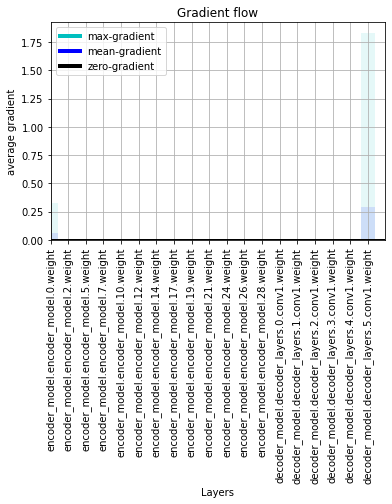

weights: [1, 0, 0, 0, 0, 0]
Iter: 10 | Train loss on last  10 : total - 21.16769425868988, content-31.416970443725585, style-21.164552640914916


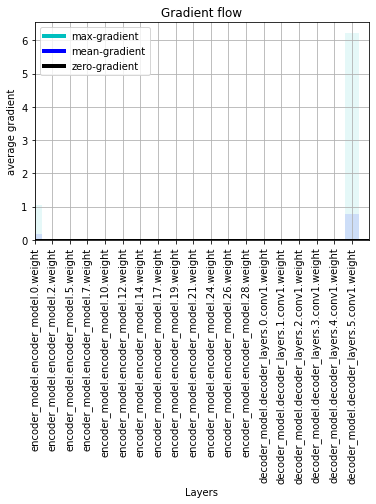

weights: [1, 0, 0, 0, 0, 0]
Iter: 20 | Train loss on last  10 : total - 18.036429786682127, content-33.74014129638672, style-18.03305587768555


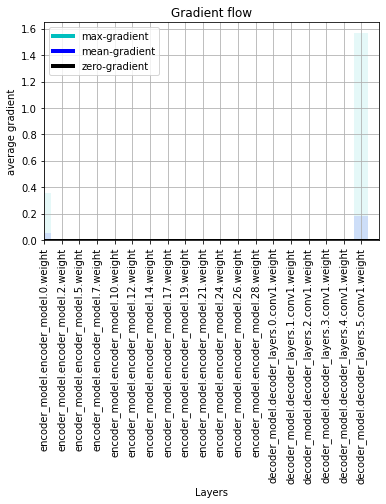

weights: [1, 0, 0, 0, 0, 0]
Iter: 30 | Train loss on last  10 : total - 16.059459948539732, content-32.40554237365723, style-16.056219339370728


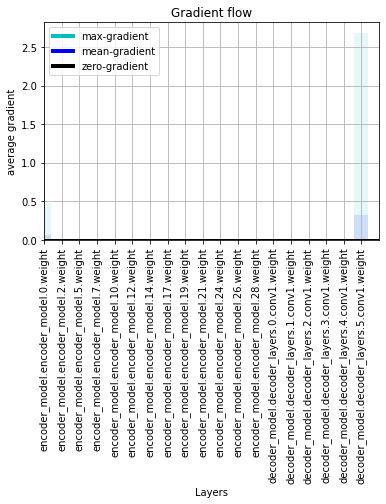

weights: [1, 0, 0, 0, 0, 0]
Iter: 40 | Train loss on last  10 : total - 16.90162351131439, content-33.106665992736815, style-16.89831323623657


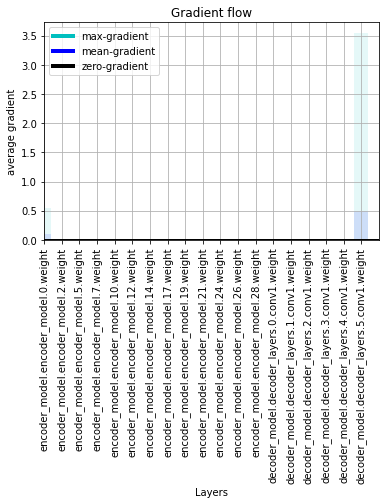

weights: [1, 0, 0, 0, 0, 0]
Iter: 50 | Train loss on last  10 : total - 23.22346043586731, content-36.41884346008301, style-23.219818663597106


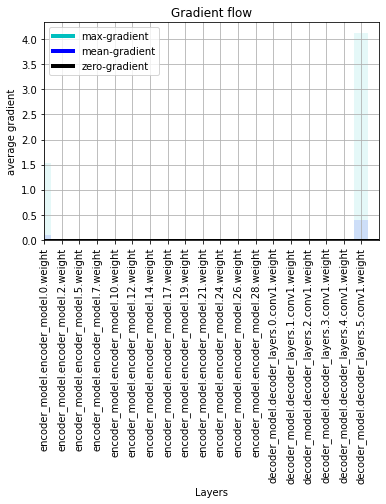

weights: [1, 0, 0, 0, 0, 0]
Iter: 60 | Train loss on last  10 : total - 11.647228407859803, content-31.997288513183594, style-11.644028878211975


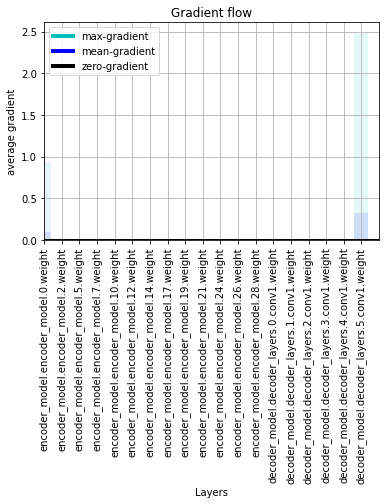

weights: [1, 0, 0, 0, 0, 0]
Iter: 70 | Train loss on last  10 : total - 16.656461668014526, content-30.380672264099122, style-16.653423500061034


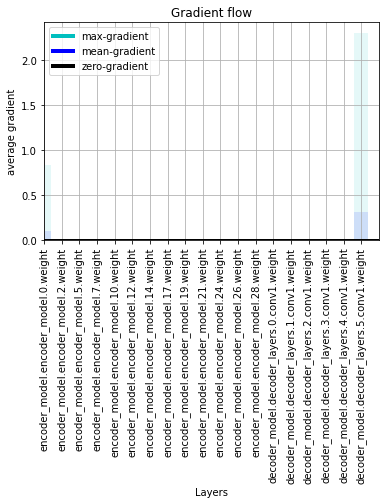

weights: [1, 0, 0, 0, 0, 0]
Iter: 80 | Train loss on last  10 : total - 33.14830099344253, content-31.407625198364258, style-33.145159566402434


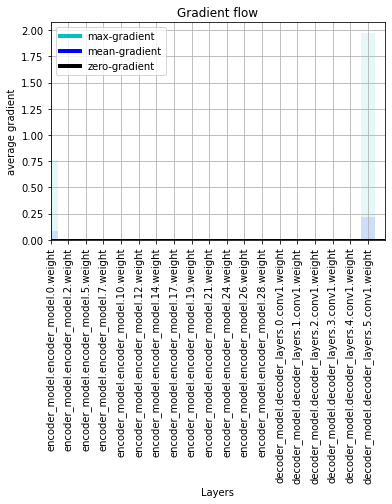

weights: [1, 0, 0, 0, 0, 0]
Iter: 90 | Train loss on last  10 : total - 12.321276330947876, content-32.82412586212158, style-12.317993879318237


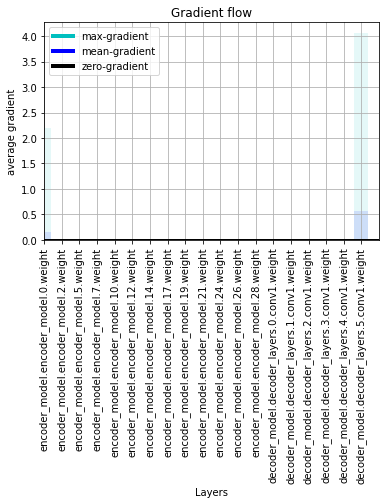

weights: [1, 0, 0, 0, 0, 0]
Iter: 100 | Train loss on last  10 : total - 26.78320801258087, content-35.172282981872556, style-26.77969100475311


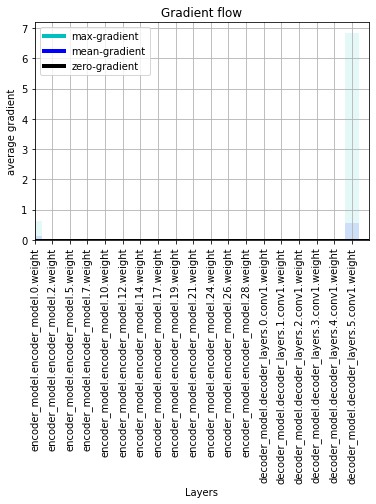

weights: [1, 0, 0, 0, 0, 0]
Iter: 110 | Train loss on last  10 : total - 18.727363181114196, content-36.36020851135254, style-18.723727202415468


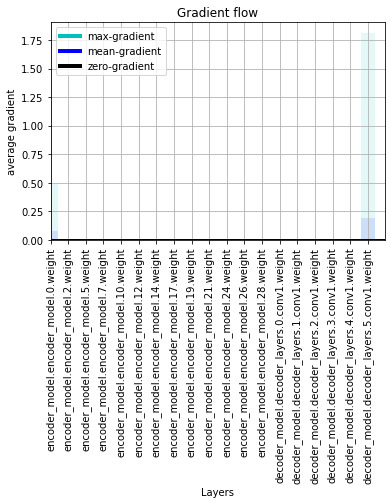

weights: [1, 0, 0, 0, 0, 0]
Iter: 120 | Train loss on last  10 : total - 16.943591284751893, content-32.32032585144043, style-16.940359473228455
Train layer: 1, num steps:256, number of trained parameters: 184576
14


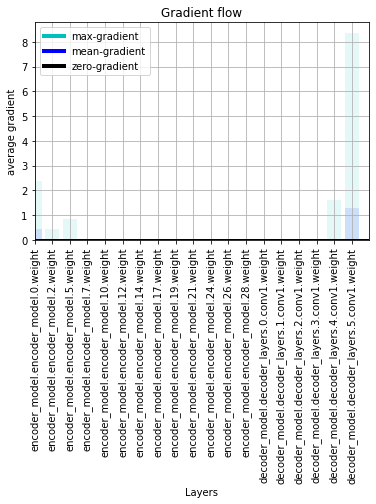

weights: [0, 1, 0, 0, 0, 0]
Iter: 10 | Train loss on last  10 : total - 21.469921922683717, content-40.23005714416504, style-21.429691743850707


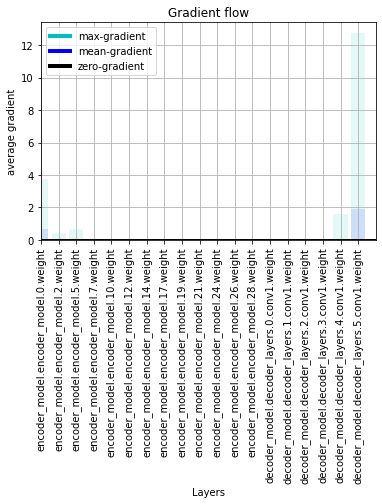

weights: [0, 1, 0, 0, 0, 0]
Iter: 20 | Train loss on last  10 : total - 22.407301330566405, content-38.61844749450684, style-22.36868271827698


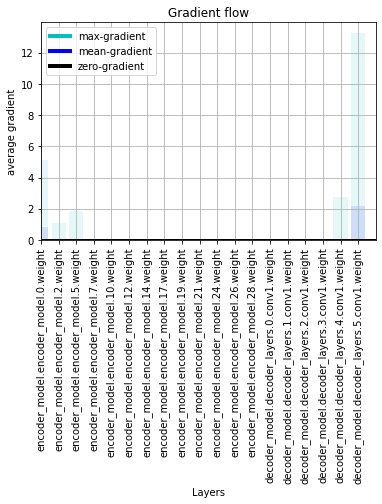

weights: [0, 1, 0, 0, 0, 0]
Iter: 30 | Train loss on last  10 : total - 32.41122364997864, content-40.38480453491211, style-32.370838737487794


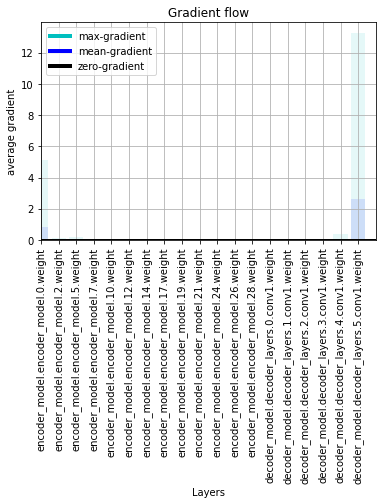

weights: [0, 1, 0, 0, 0, 0]
Iter: 40 | Train loss on last  10 : total - 14.33373737335205, content-40.57444686889649, style-14.293162965774536


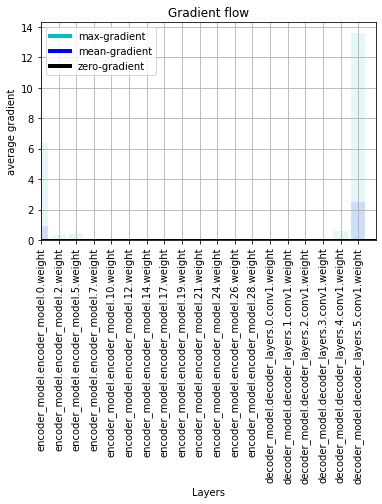

weights: [0, 1, 0, 0, 0, 0]
Iter: 50 | Train loss on last  10 : total - 24.437008357048036, content-35.46191253662109, style-24.40154626369476


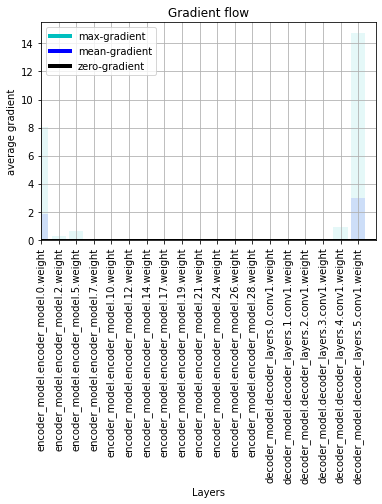

weights: [0, 1, 0, 0, 0, 0]
Iter: 60 | Train loss on last  10 : total - 21.504348587989806, content-44.26406593322754, style-21.460084199905396


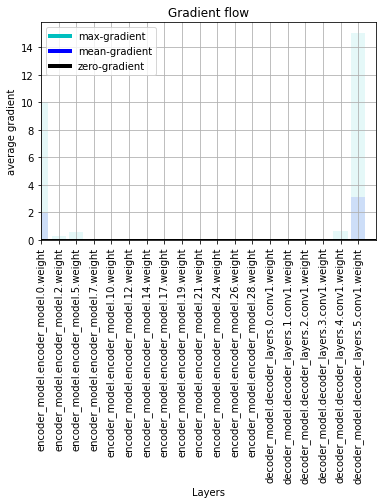

weights: [0, 1, 0, 0, 0, 0]
Iter: 70 | Train loss on last  10 : total - 24.29947347640991, content-36.902248764038085, style-24.262571334838867


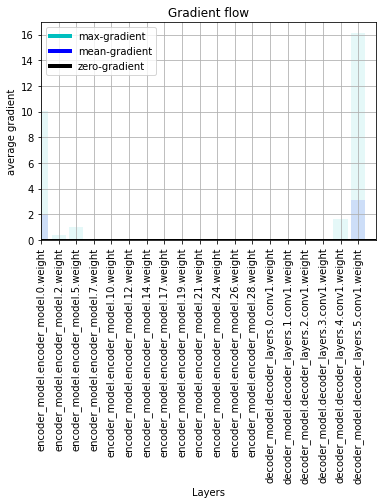

weights: [0, 1, 0, 0, 0, 0]
Iter: 80 | Train loss on last  10 : total - 25.772287034988402, content-36.89415664672852, style-25.73539295196533


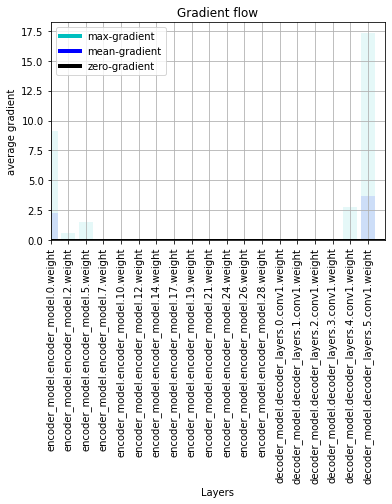

weights: [0, 1, 0, 0, 0, 0]
Iter: 90 | Train loss on last  10 : total - 12.639445519447326, content-34.05363159179687, style-12.605391955375671


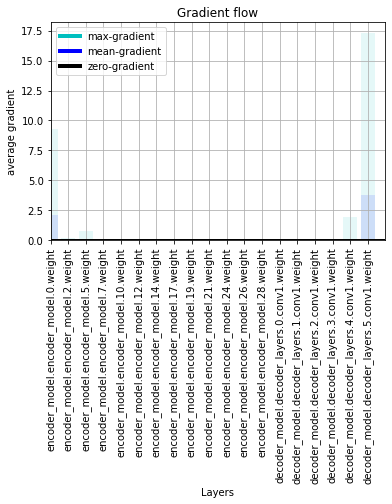

weights: [0, 1, 0, 0, 0, 0]
Iter: 100 | Train loss on last  10 : total - 15.067633557319642, content-39.89515132904053, style-15.02773859500885


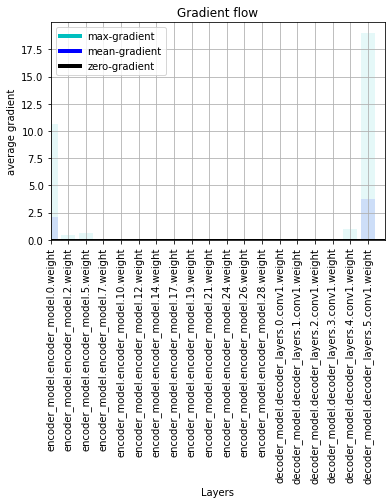

weights: [0, 1, 0, 0, 0, 0]
Iter: 110 | Train loss on last  10 : total - 11.742012643814087, content-34.25380859375, style-11.707758855819701


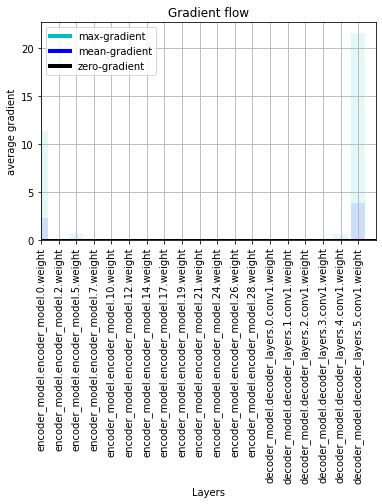

weights: [0, 1, 0, 0, 0, 0]
Iter: 120 | Train loss on last  10 : total - 14.961001992225647, content-36.84795227050781, style-14.924153804779053


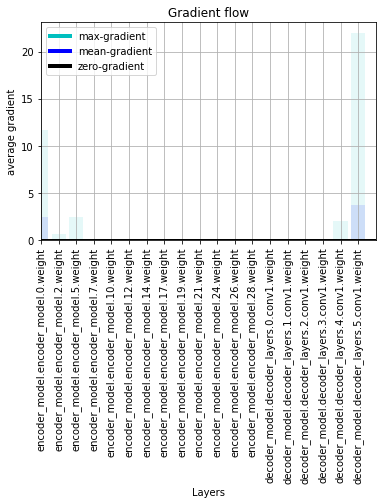

weights: [0, 1, 0, 0, 0, 0]
Iter: 130 | Train loss on last  10 : total - 17.053846406936646, content-39.26273651123047, style-17.014584016799926


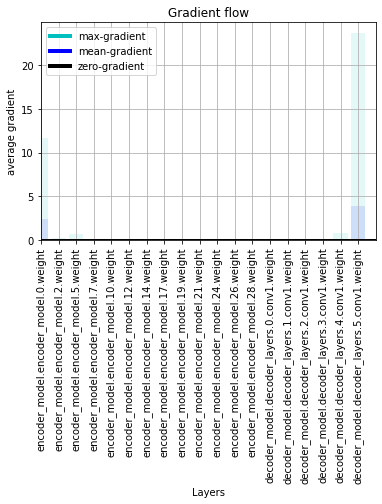

weights: [0, 1, 0, 0, 0, 0]
Iter: 140 | Train loss on last  10 : total - 8.371402931213378, content-37.37461395263672, style-8.334028291702271


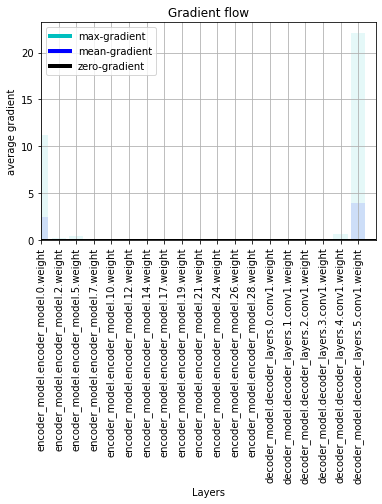

weights: [0, 1, 0, 0, 0, 0]
Iter: 150 | Train loss on last  10 : total - 13.120740163326264, content-35.19483489990235, style-13.085545265674591


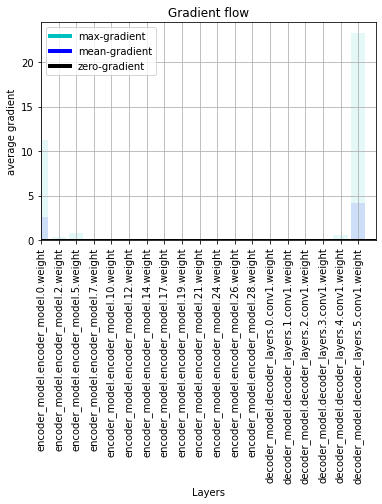

weights: [0, 1, 0, 0, 0, 0]
Iter: 160 | Train loss on last  10 : total - 15.24833858013153, content-37.40966682434082, style-15.21092872619629


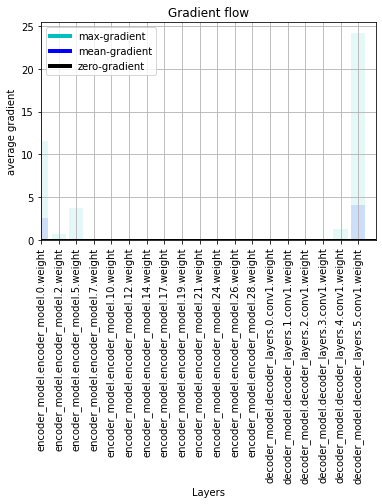

weights: [0, 1, 0, 0, 0, 0]
Iter: 170 | Train loss on last  10 : total - 15.10692594051361, content-37.99100475311279, style-15.06893458366394


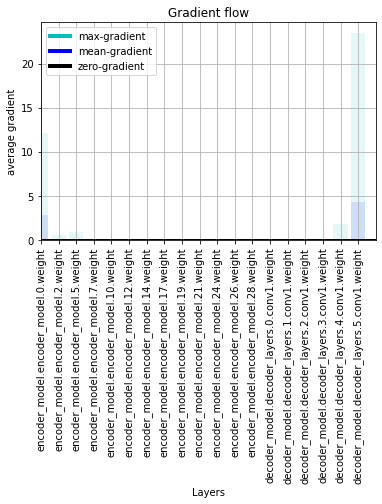

weights: [0, 1, 0, 0, 0, 0]
Iter: 180 | Train loss on last  10 : total - 11.984547352790832, content-40.349749374389646, style-11.944197916984558


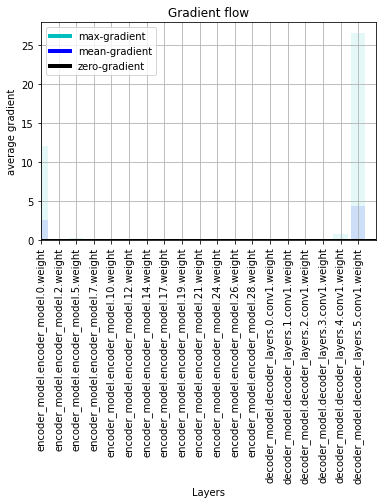

weights: [0, 1, 0, 0, 0, 0]
Iter: 190 | Train loss on last  10 : total - 11.704891157150268, content-36.021966743469235, style-11.668869066238404


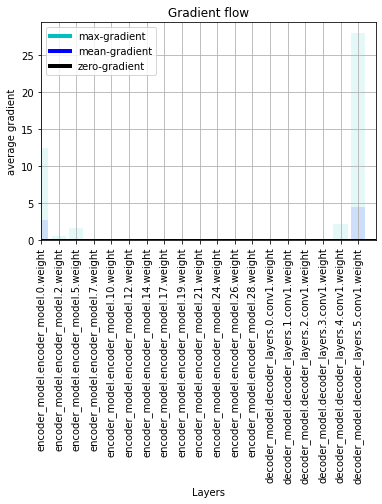

weights: [0, 1, 0, 0, 0, 0]
Iter: 200 | Train loss on last  10 : total - 11.81807463169098, content-40.169704818725585, style-11.777904915809632


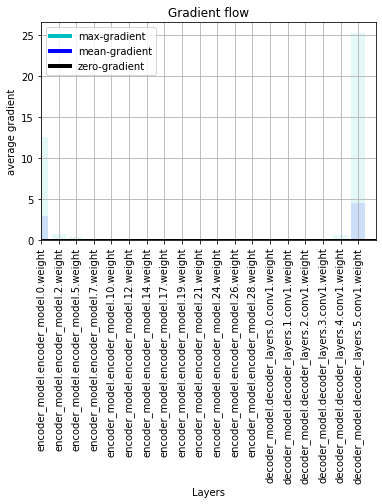

weights: [0, 1, 0, 0, 0, 0]
Iter: 210 | Train loss on last  10 : total - 13.743304109573364, content-35.600484466552736, style-13.707703399658204


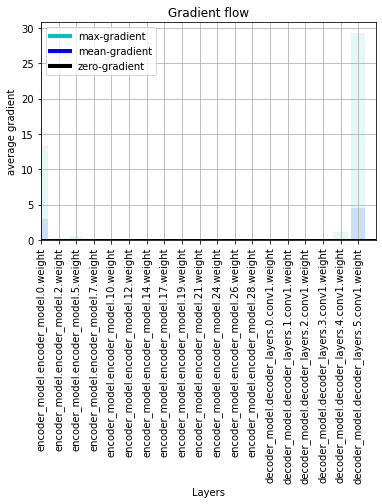

weights: [0, 1, 0, 0, 0, 0]
Iter: 220 | Train loss on last  10 : total - 11.460667157173157, content-35.747920989990234, style-11.42491900920868


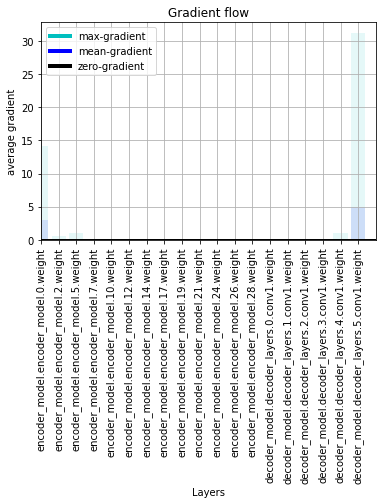

weights: [0, 1, 0, 0, 0, 0]
Iter: 230 | Train loss on last  10 : total - 16.8579213142395, content-39.079714965820315, style-16.818841338157654


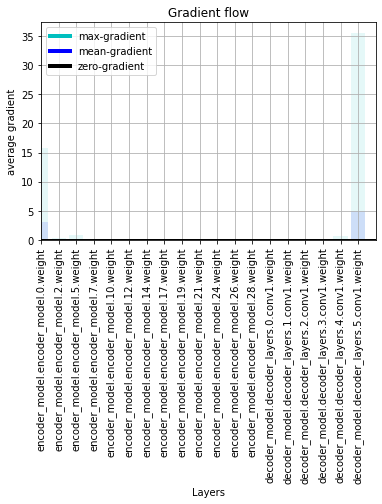

weights: [0, 1, 0, 0, 0, 0]
Iter: 240 | Train loss on last  10 : total - 16.69293603897095, content-38.44004573822021, style-16.65449595451355


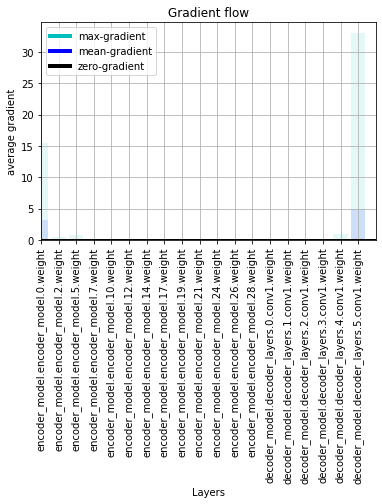

weights: [0, 1, 0, 0, 0, 0]
Iter: 250 | Train loss on last  10 : total - 20.518244791030884, content-40.564337730407715, style-20.477680444717407
Train layer: 2, num steps:512, number of trained parameters: 737792
14


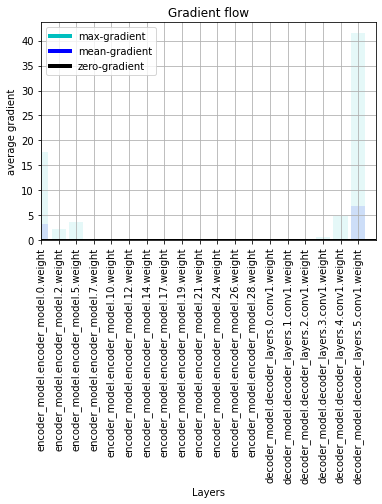

weights: [0, 0, 1, 0, 0, 0]
Iter: 10 | Train loss on last  10 : total - 21.354303550720214, content-47.93391342163086, style-20.874964714050293


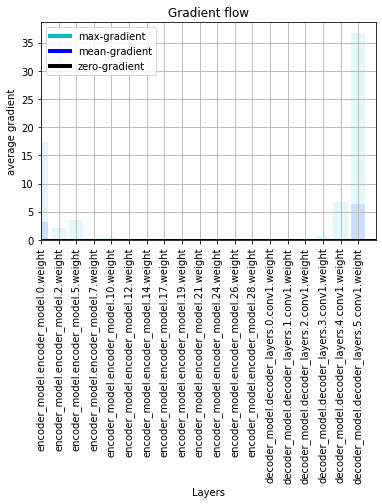

weights: [0, 0, 1, 0, 0, 0]
Iter: 20 | Train loss on last  10 : total - 12.816162919998169, content-42.83163986206055, style-12.38784646987915


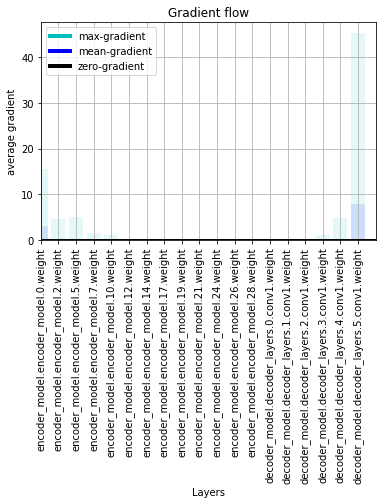

weights: [0, 0, 1, 0, 0, 0]
Iter: 30 | Train loss on last  10 : total - 15.905162525177001, content-46.36693153381348, style-15.441492938995362


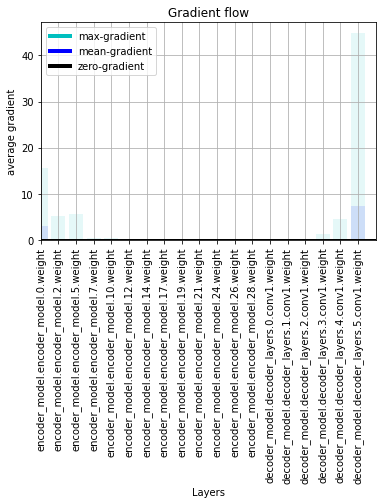

weights: [0, 0, 1, 0, 0, 0]
Iter: 40 | Train loss on last  10 : total - 9.939051628112793, content-44.32000732421875, style-9.495851683616639


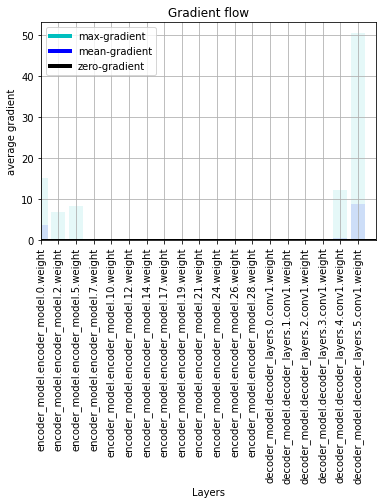

weights: [0, 0, 1, 0, 0, 0]
Iter: 50 | Train loss on last  10 : total - 21.06723201274872, content-45.85725898742676, style-20.60865957736969


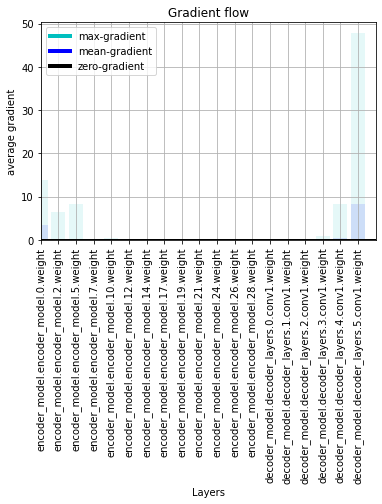

weights: [0, 0, 1, 0, 0, 0]
Iter: 60 | Train loss on last  10 : total - 15.980866479873658, content-44.60765914916992, style-15.534790062904358


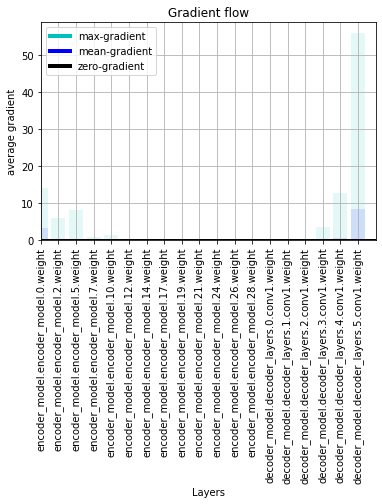

weights: [0, 0, 1, 0, 0, 0]
Iter: 70 | Train loss on last  10 : total - 30.408131074905395, content-47.93622245788574, style-29.928768968582155


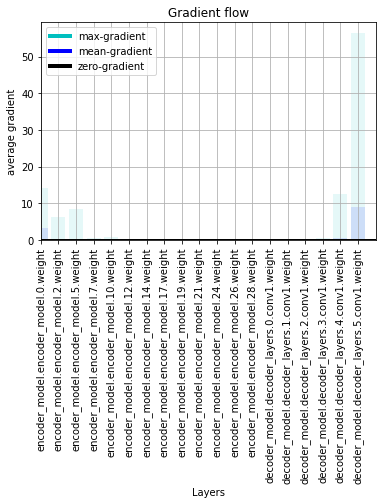

weights: [0, 0, 1, 0, 0, 0]
Iter: 80 | Train loss on last  10 : total - 16.49638452529907, content-50.03110237121582, style-15.996073627471924


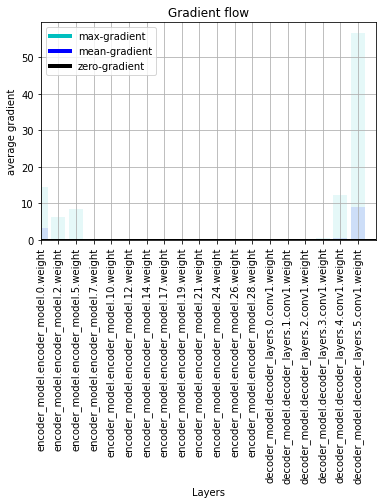

weights: [0, 0, 1, 0, 0, 0]
Iter: 90 | Train loss on last  10 : total - 7.664968013763428, content-39.494437026977536, style-7.270023703575134


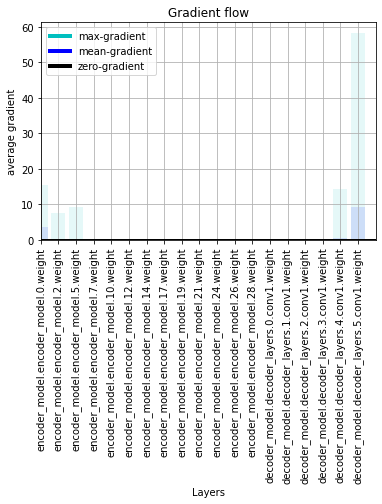

weights: [0, 0, 1, 0, 0, 0]
Iter: 100 | Train loss on last  10 : total - 9.563791608810424, content-45.66545734405518, style-9.107136988639832


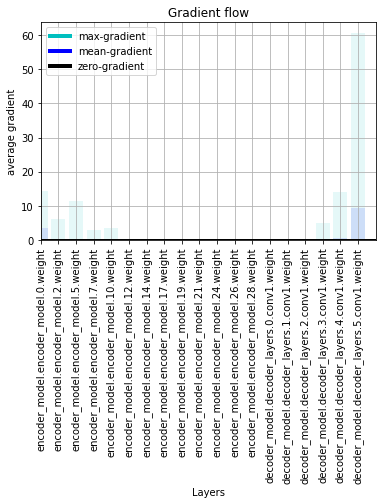

weights: [0, 0, 1, 0, 0, 0]
Iter: 110 | Train loss on last  10 : total - 23.576673555374146, content-49.73960838317871, style-23.07927761077881


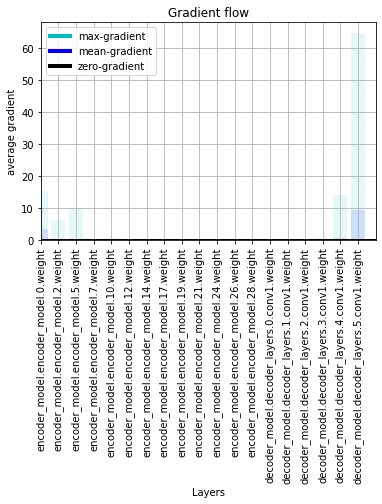

weights: [0, 0, 1, 0, 0, 0]
Iter: 120 | Train loss on last  10 : total - 17.217573952674865, content-48.90843238830566, style-16.728489542007445


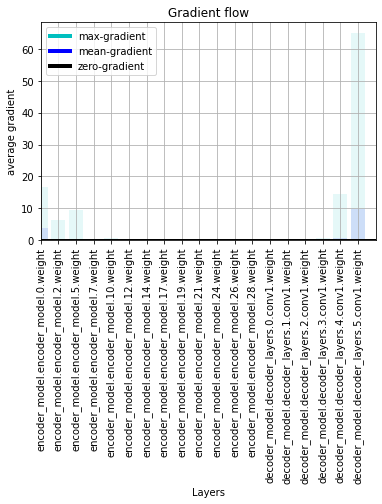

weights: [0, 0, 1, 0, 0, 0]
Iter: 130 | Train loss on last  10 : total - 13.244495296478272, content-47.25265731811523, style-12.771968758106231


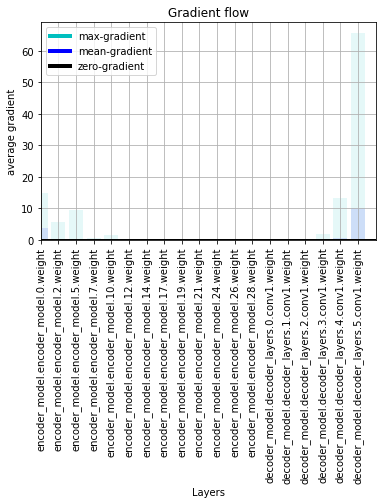

weights: [0, 0, 1, 0, 0, 0]
Iter: 140 | Train loss on last  10 : total - 21.625123023986816, content-48.17043571472168, style-21.143419122695924


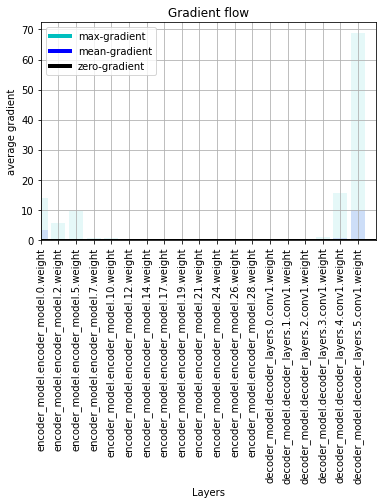

weights: [0, 0, 1, 0, 0, 0]
Iter: 150 | Train loss on last  10 : total - 27.043402433395386, content-50.92685546875, style-26.53413345813751


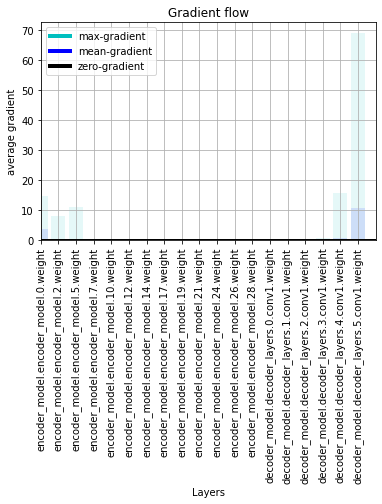

weights: [0, 0, 1, 0, 0, 0]
Iter: 160 | Train loss on last  10 : total - 15.192852425575257, content-49.356044387817384, style-14.6992919921875


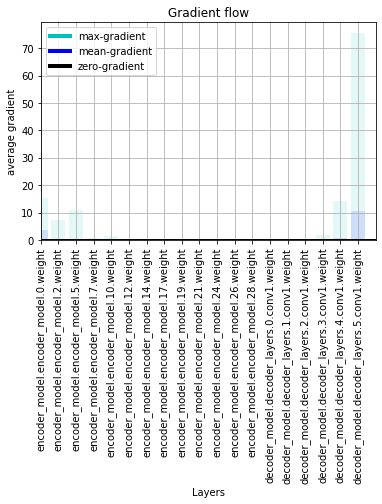

weights: [0, 0, 1, 0, 0, 0]
Iter: 170 | Train loss on last  10 : total - 15.239640498161316, content-44.921073532104494, style-14.7904296875


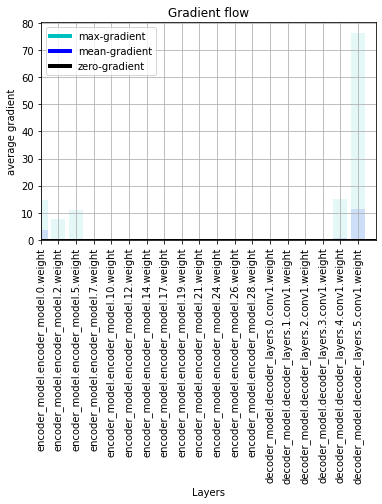

weights: [0, 0, 1, 0, 0, 0]
Iter: 180 | Train loss on last  10 : total - 8.576663827896118, content-47.22305870056152, style-8.104433178901672


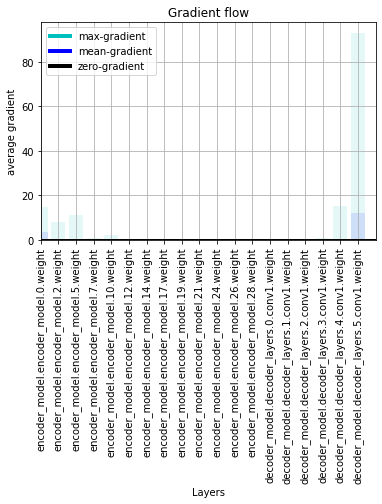

weights: [0, 0, 1, 0, 0, 0]
Iter: 190 | Train loss on last  10 : total - 22.809612274169922, content-49.08891372680664, style-22.31872351169586


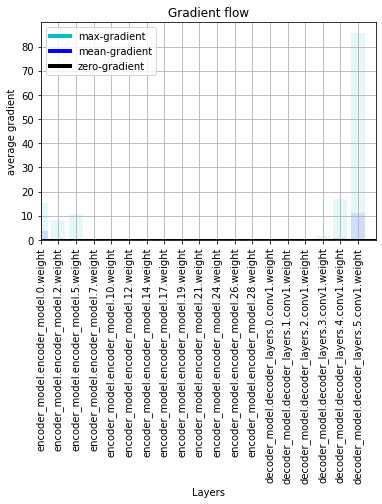

weights: [0, 0, 1, 0, 0, 0]
Iter: 200 | Train loss on last  10 : total - 15.684815073013306, content-49.31222381591797, style-15.191692876815797


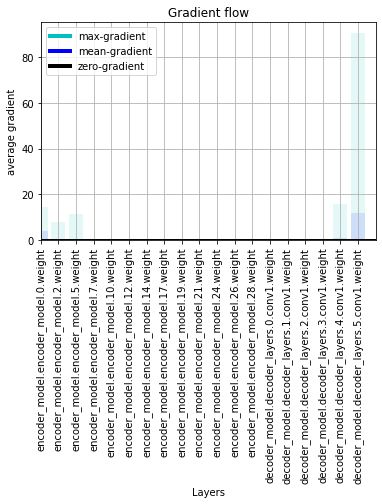

weights: [0, 0, 1, 0, 0, 0]
Iter: 210 | Train loss on last  10 : total - 16.326101183891296, content-48.12331848144531, style-15.844867753982545


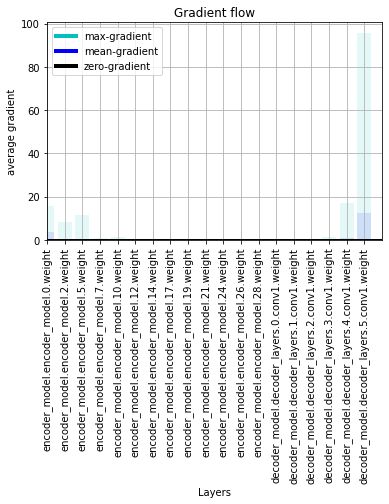

weights: [0, 0, 1, 0, 0, 0]
Iter: 220 | Train loss on last  10 : total - 18.180027270317076, content-50.49891204833985, style-17.67503786087036


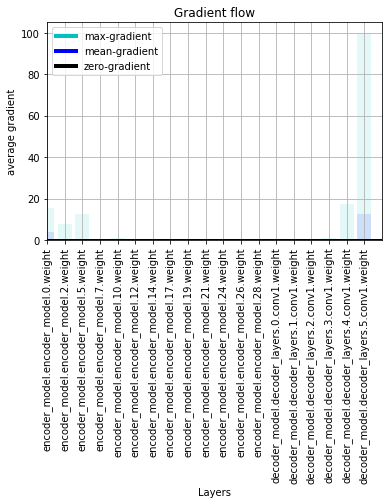

weights: [0, 0, 1, 0, 0, 0]
Iter: 230 | Train loss on last  10 : total - 18.121339321136475, content-45.37688293457031, style-17.667570614814757


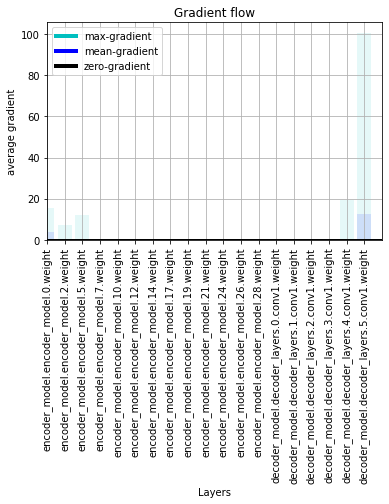

weights: [0, 0, 1, 0, 0, 0]
Iter: 240 | Train loss on last  10 : total - 12.285623049736023, content-44.47552719116211, style-11.840867924690247


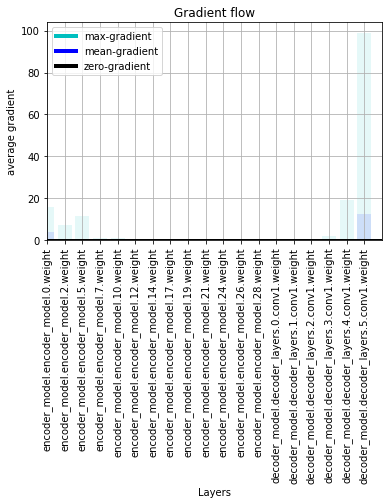

weights: [0, 0, 1, 0, 0, 0]
Iter: 250 | Train loss on last  10 : total - 9.915116000175477, content-46.11554794311523, style-9.453960585594178


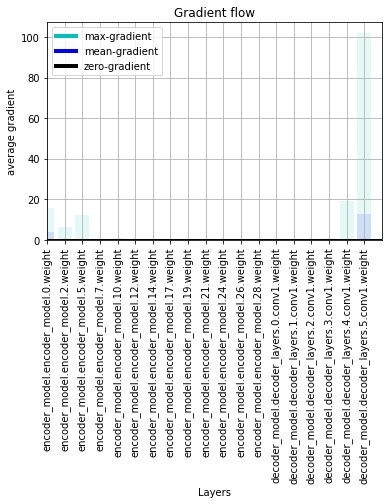

weights: [0, 0, 1, 0, 0, 0]
Iter: 260 | Train loss on last  10 : total - 13.435433936119079, content-51.266652297973636, style-12.922767329216004


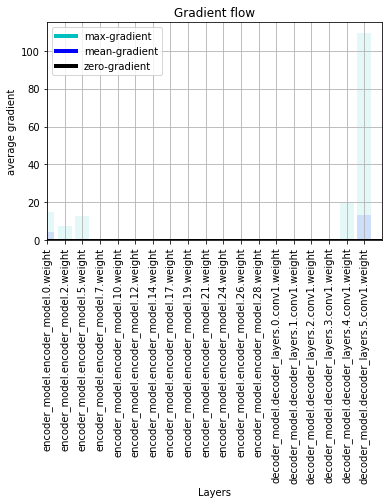

weights: [0, 0, 1, 0, 0, 0]
Iter: 270 | Train loss on last  10 : total - 14.61070876121521, content-50.39763717651367, style-14.106732439994811


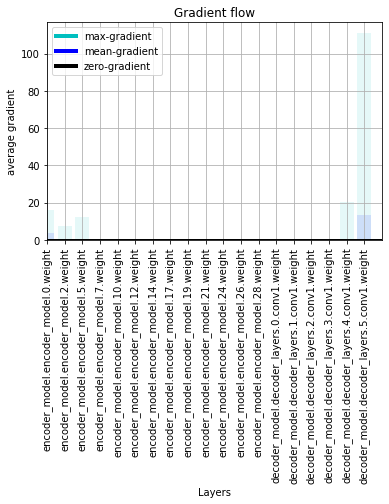

weights: [0, 0, 1, 0, 0, 0]
Iter: 280 | Train loss on last  10 : total - 15.474054503440858, content-48.17556610107422, style-14.992298817634582


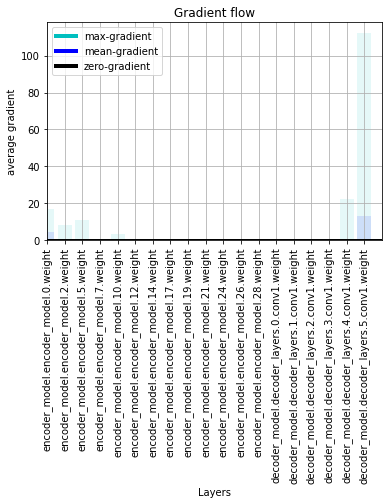

weights: [0, 0, 1, 0, 0, 0]
Iter: 290 | Train loss on last  10 : total - 12.844296765327453, content-43.87428855895996, style-12.405553960800171


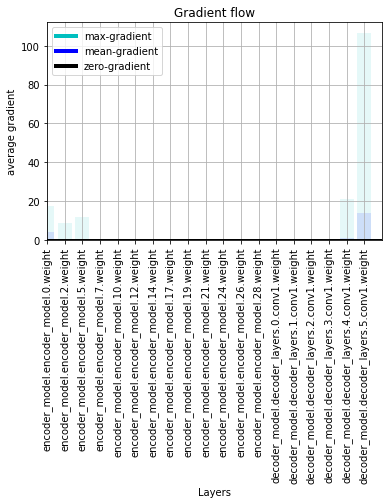

weights: [0, 0, 1, 0, 0, 0]
Iter: 300 | Train loss on last  10 : total - 11.861698627471924, content-50.55058288574219, style-11.356192934513093


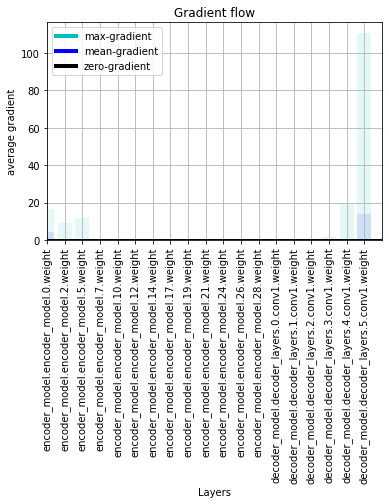

weights: [0, 0, 1, 0, 0, 0]
Iter: 310 | Train loss on last  10 : total - 9.227657651901245, content-45.03175640106201, style-8.777340078353882


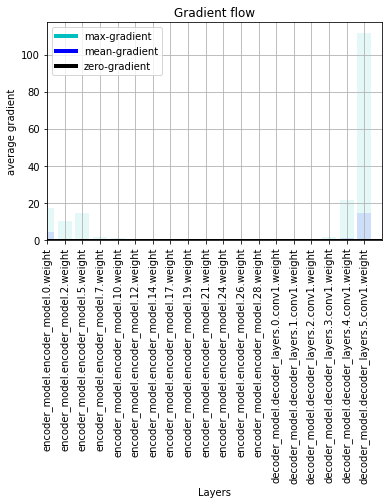

weights: [0, 0, 1, 0, 0, 0]
Iter: 320 | Train loss on last  10 : total - 11.381458568572999, content-50.21862258911133, style-10.879272437095642


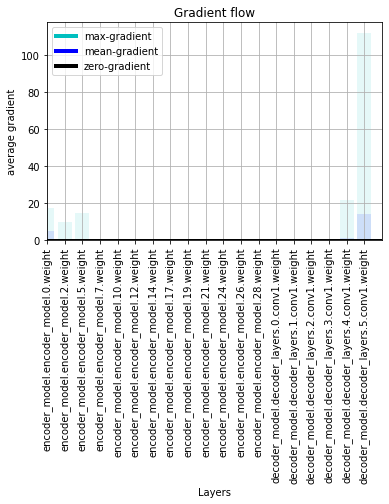

weights: [0, 0, 1, 0, 0, 0]
Iter: 330 | Train loss on last  10 : total - 8.951462936401366, content-48.25053787231445, style-8.46895765066147


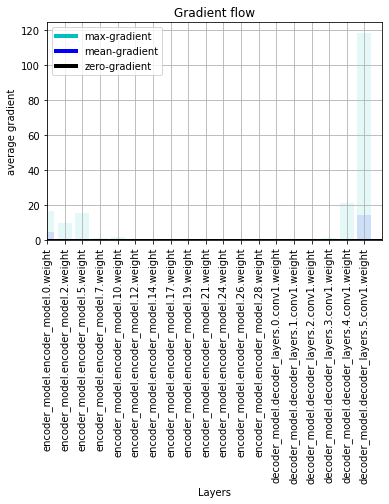

weights: [0, 0, 1, 0, 0, 0]
Iter: 340 | Train loss on last  10 : total - 18.045811104774476, content-49.22283821105957, style-17.55358235836029


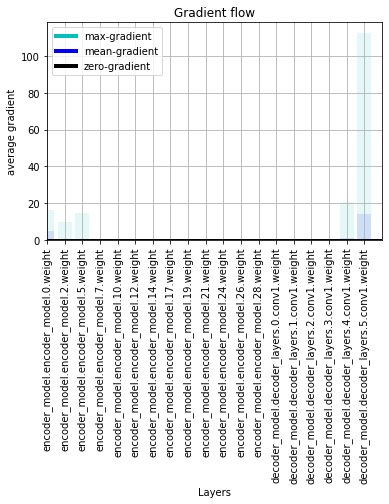

weights: [0, 0, 1, 0, 0, 0]
Iter: 350 | Train loss on last  10 : total - 9.066502141952515, content-46.01103401184082, style-8.606391787528992


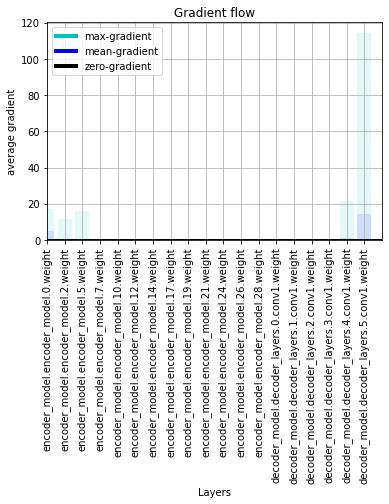

weights: [0, 0, 1, 0, 0, 0]
Iter: 360 | Train loss on last  10 : total - 20.609158849716188, content-53.499456787109374, style-20.074163961410523


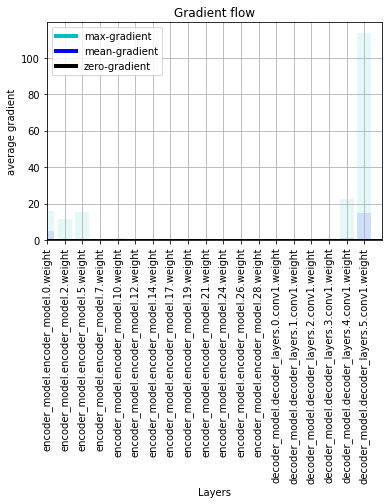

weights: [0, 0, 1, 0, 0, 0]
Iter: 370 | Train loss on last  10 : total - 15.4941077709198, content-52.09238395690918, style-14.973184084892273


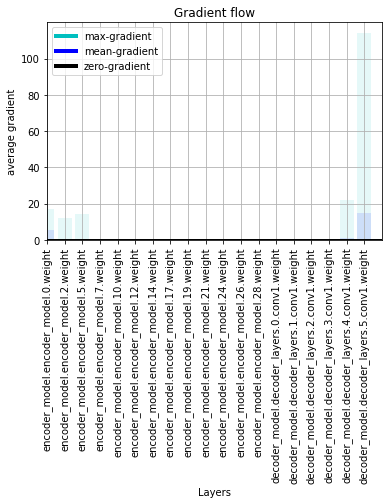

weights: [0, 0, 1, 0, 0, 0]
Iter: 380 | Train loss on last  10 : total - 16.08668624162674, content-49.14997940063476, style-15.595186591148376


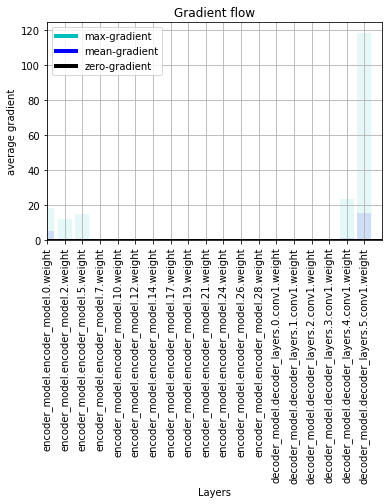

weights: [0, 0, 1, 0, 0, 0]
Iter: 390 | Train loss on last  10 : total - 19.161729407310485, content-51.00431938171387, style-18.65168603658676


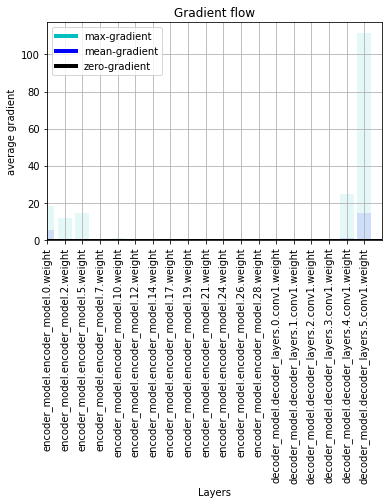

weights: [0, 0, 1, 0, 0, 0]
Iter: 400 | Train loss on last  10 : total - 13.868266701698303, content-54.33462638854981, style-13.324920463562012


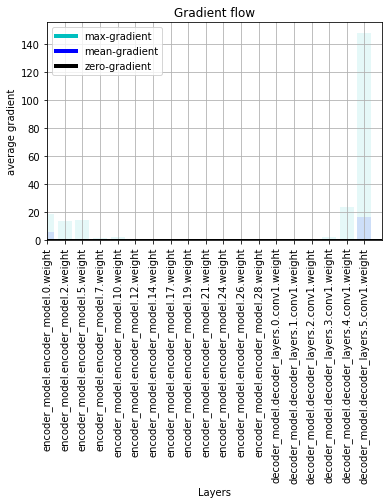

weights: [0, 0, 1, 0, 0, 0]
Iter: 410 | Train loss on last  10 : total - 11.252641773223877, content-48.42478256225586, style-10.768393778800965


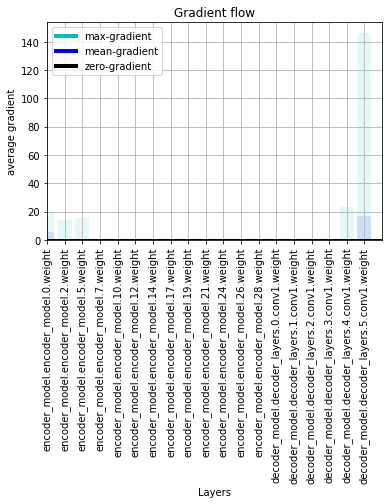

weights: [0, 0, 1, 0, 0, 0]
Iter: 420 | Train loss on last  10 : total - 13.732529711723327, content-49.67136154174805, style-13.235816192626952


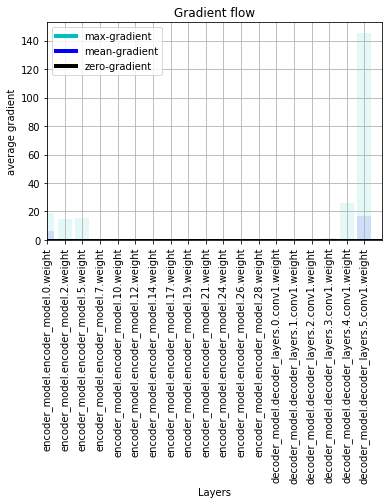

weights: [0, 0, 1, 0, 0, 0]
Iter: 430 | Train loss on last  10 : total - 15.852702736854553, content-44.04182586669922, style-15.412284564971923


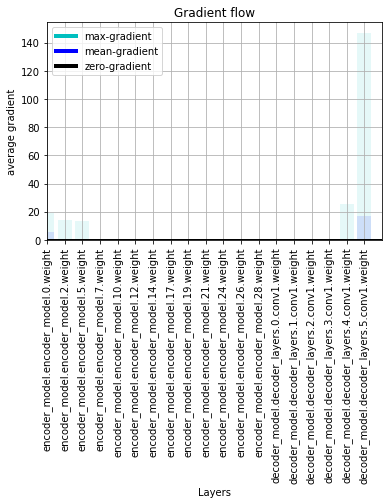

weights: [0, 0, 1, 0, 0, 0]
Iter: 440 | Train loss on last  10 : total - 5.391409206390381, content-46.4376106262207, style-4.927033162117004


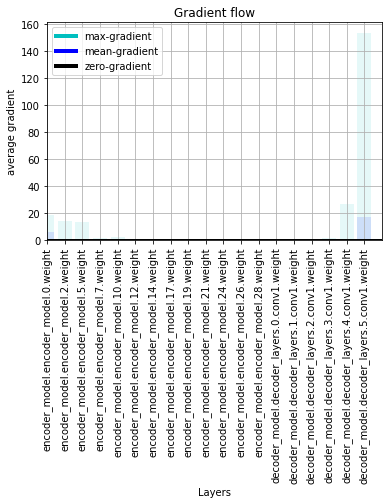

weights: [0, 0, 1, 0, 0, 0]
Iter: 450 | Train loss on last  10 : total - 22.36851348876953, content-55.174119567871095, style-21.816772651672363


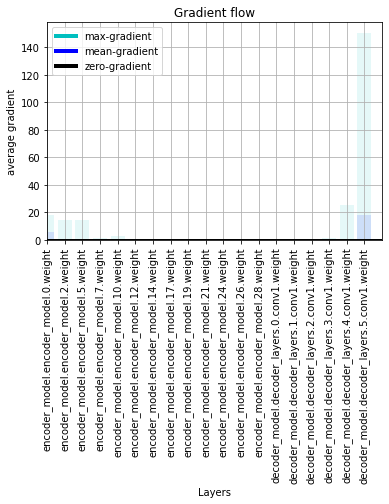

weights: [0, 0, 1, 0, 0, 0]
Iter: 460 | Train loss on last  10 : total - 10.663242983818055, content-47.030924224853514, style-10.192933893203735


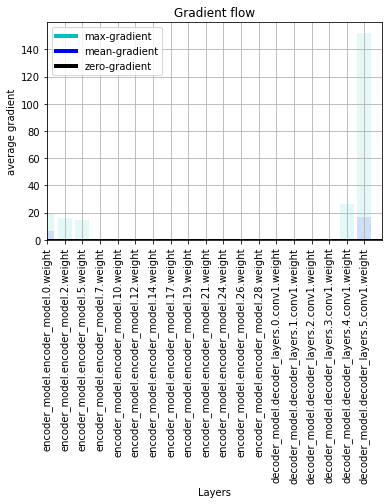

weights: [0, 0, 1, 0, 0, 0]
Iter: 470 | Train loss on last  10 : total - 10.890311336517334, content-50.551129531860354, style-10.384800148010253


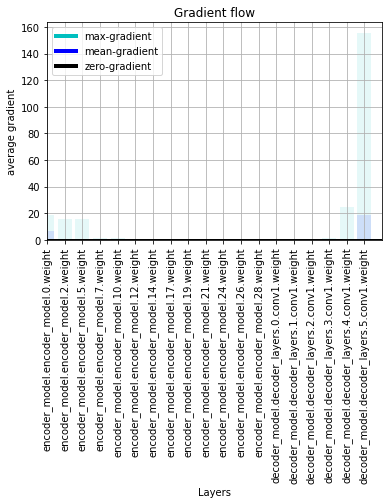

weights: [0, 0, 1, 0, 0, 0]
Iter: 480 | Train loss on last  10 : total - 23.13109471797943, content-51.61761627197266, style-22.614918541908263


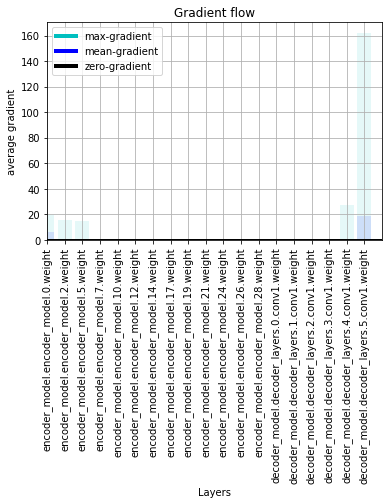

weights: [0, 0, 1, 0, 0, 0]
Iter: 490 | Train loss on last  10 : total - 12.581973004341126, content-48.11009292602539, style-12.100872015953064


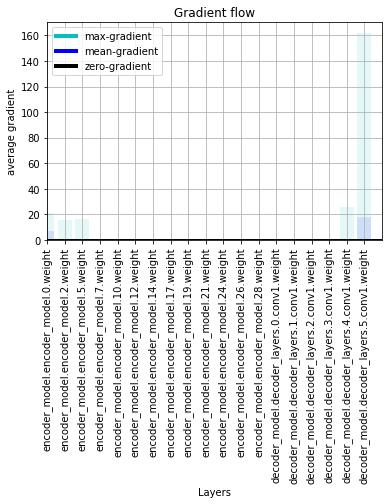

weights: [0, 0, 1, 0, 0, 0]
Iter: 500 | Train loss on last  10 : total - 16.025581550598144, content-45.45319709777832, style-15.571049356460572


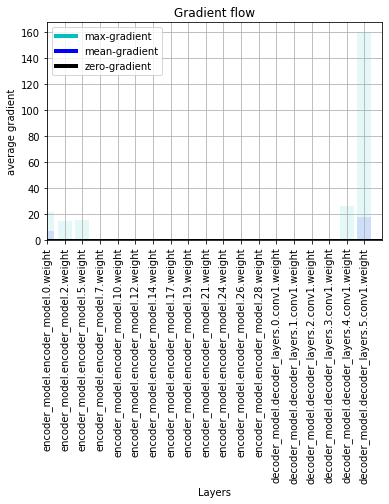

weights: [0, 0, 1, 0, 0, 0]
Iter: 510 | Train loss on last  10 : total - 9.760383415222169, content-49.8913631439209, style-9.261469602584839
Train layer: 3, num steps:0, number of trained parameters: 3540224
14
Train layer: 4, num steps:0, number of trained parameters: 9439232
14
Train layer: 5, num steps:0, number of trained parameters: 7079424
14


In [41]:
'''
set all weights on skip connections are equal 1
main_model.weights = [1 for i in range(len(main_model.weights))]

main_model, writer, grad_dict = train(main_model,
                                    Adam,
                                    dataset_train,
                                    loss_model,
                                    1000,
                                    batch_size=3,
                                    lr=1e-4,
                                    out_frequency=20,
                                    alpha=0.1)
'''

main_model = train_all(main_model,
                       Adam,
                       dataset_train,
                       loss_model,
                       num_steps, 
                       batch_size=3,
                       lr=1e-3,
                       out_frequency=10,
                       alphas=alphas,
                       layers=layers,
                       layers_dict=unet_layers)

In [42]:
#if needs load saved model
#vgg, LAYERS_NAME, CHANNELS_SIZES = init_model('vgg', pretrained=True)
##adain = AdainBlock(LAYERS_NAME)
#decoder = DecoderBlock(CHANNELS_SIZES)


#main_model = STUNet(vgg, adain, decoder, LAYERS_NAME, CHANNELS_SIZES)

In [43]:
name = "Vgg16_512_top_model.pth"
torch.save(main_model.state_dict(), name)
main_model.load_state_dict(torch.load(name))
main_model = main_model.to(DEVICE)
main_model = main_model.eval()

In [44]:
#function for model prediction
def transfer_image(model, content_tensor, style_tensor, weights=None, show=False):
    if weights is  not None:
        assert len(model.weights) == len(weights)
        model.weights = weights

    with torch.no_grad():
        content_tensor = torch.unsqueeze(content_tensor, 0).to(DEVICE)
        style_tensor = torch.unsqueeze(style_tensor, 0).to(DEVICE)

        out_img = model(normalize(content_tensor), normalize(style_tensor))

        out_img = (out_img - out_img.min()) / \
                                    (out_img.max()- out_img.min())

        out_pil_img = transforms.ToPILImage()(out_img[0])
        content_pil_img = transforms.ToPILImage()(content_tensor[0])
        style_pil_img = transforms.ToPILImage()(style_tensor[0])
        
        if show:
            fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(30, 10))
            axes[0].imshow(out_pil_img)
            axes[1].imshow(content_pil_img)
            axes[2].imshow(style_pil_img)
            plt.show()

        return out_pil_img

Пример работы модели на тестовых парах изображений стиля и контента, веса каждого U-Net skip connection равны 1 (т.е. при максимальной силе сохранения контетна)


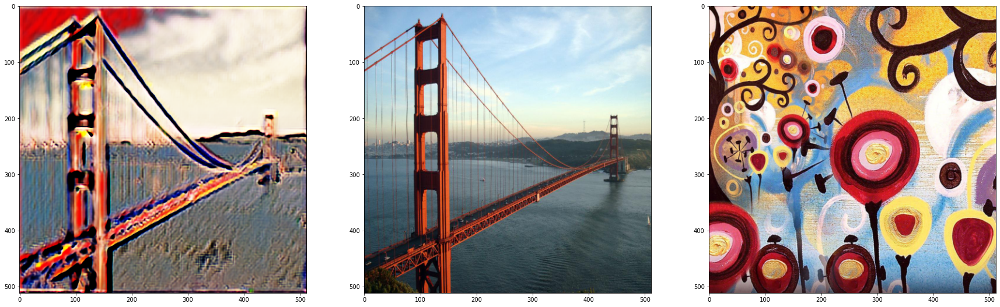

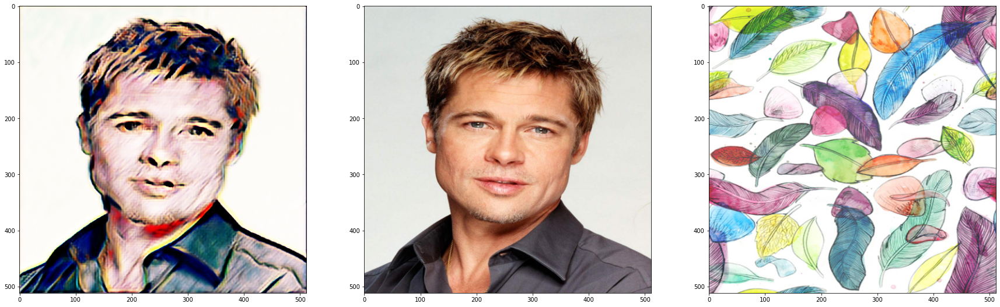

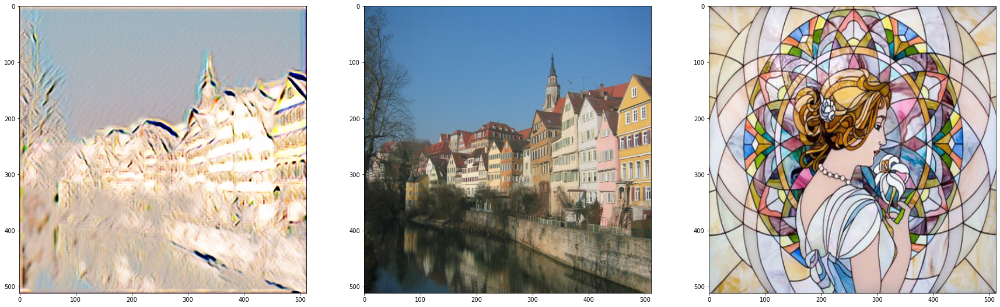

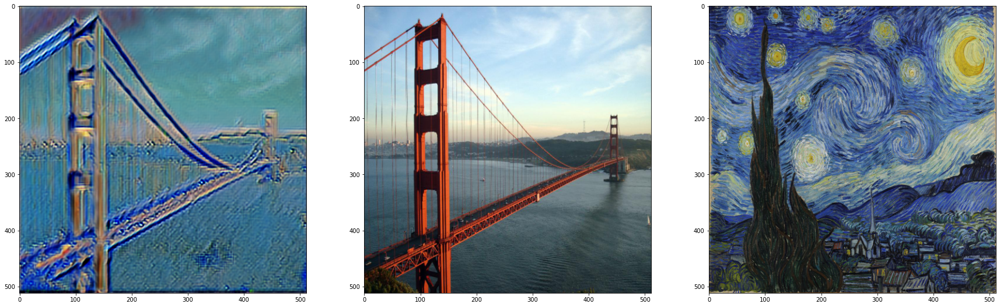

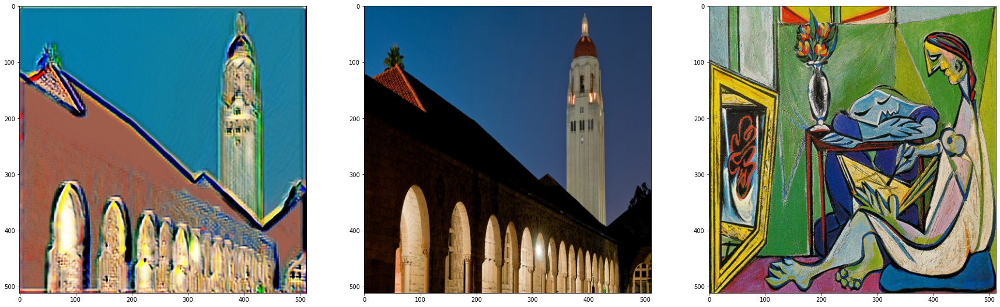

In [52]:
torch.cuda.empty_cache()
weights = [0, 0, 1, 0, 0, 0]
for i in range(5):

    contents, styles = dataset_test[np.random.randint(len(dataset_test)-1)]
    out = transfer_image(main_model, contents, styles, weights, True)

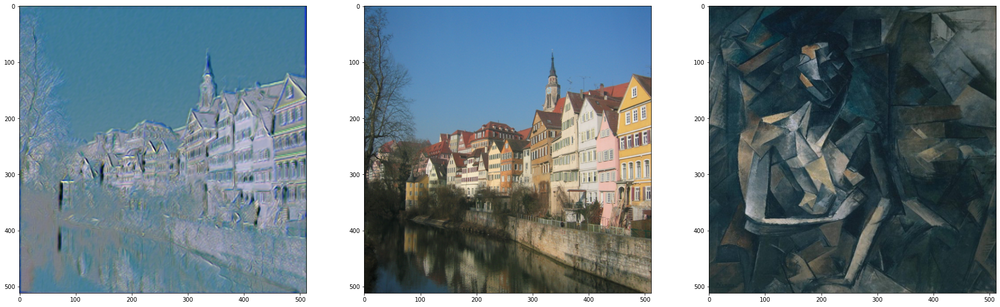

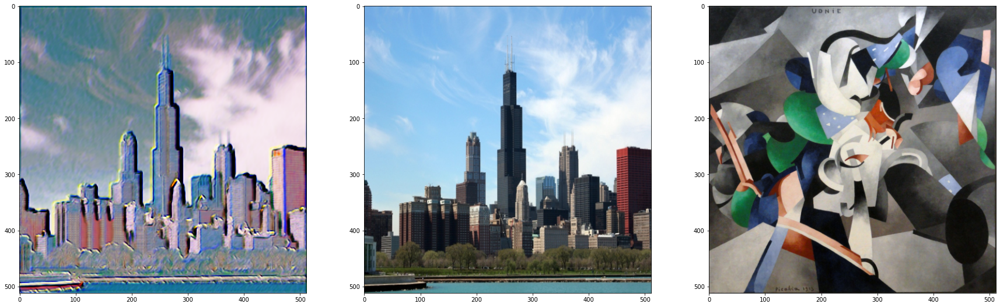

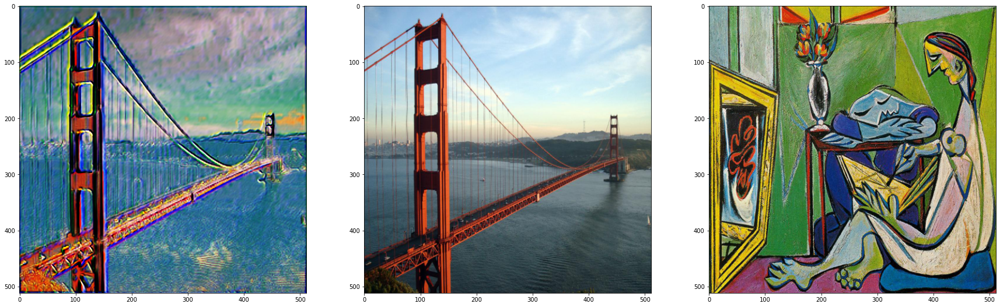

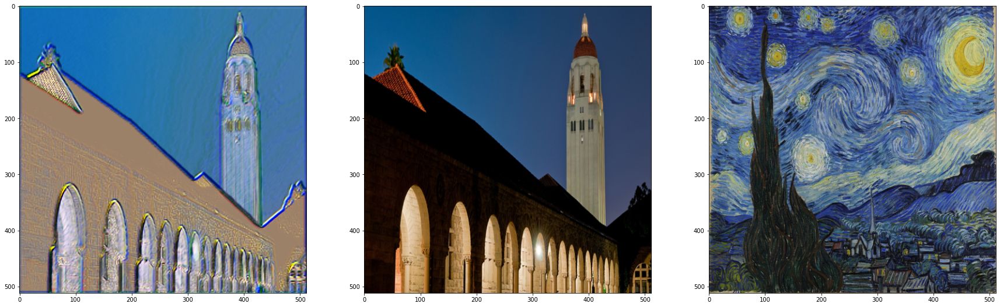

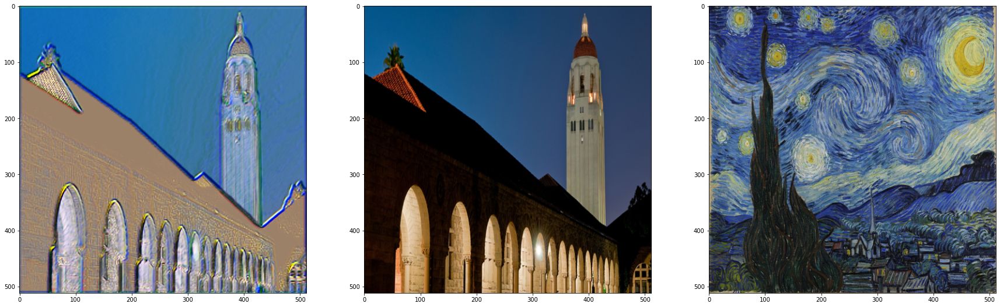

In [54]:
torch.cuda.empty_cache()
weights = [0, 1, 0, 0, 0, 0]
for i in range(5):

    contents, styles = dataset_test[np.random.randint(len(dataset_test)-1)]
    out = transfer_image(main_model, contents, styles, weights, True)

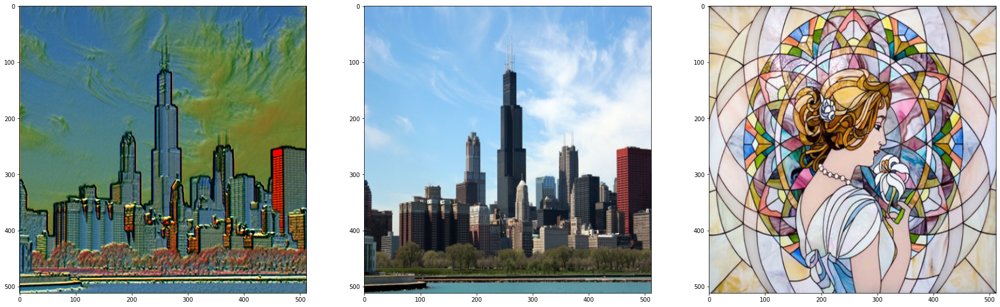

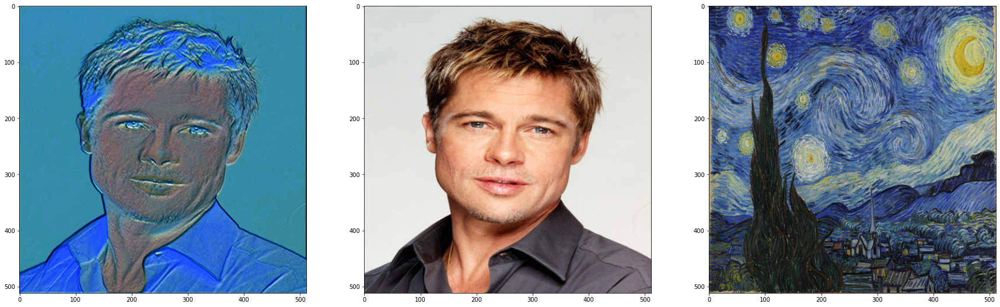

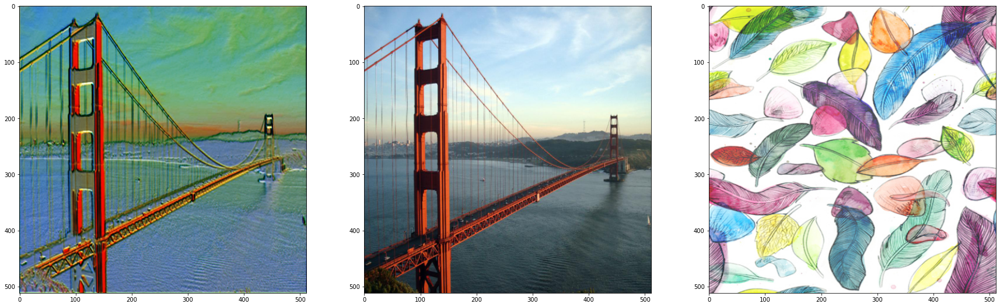

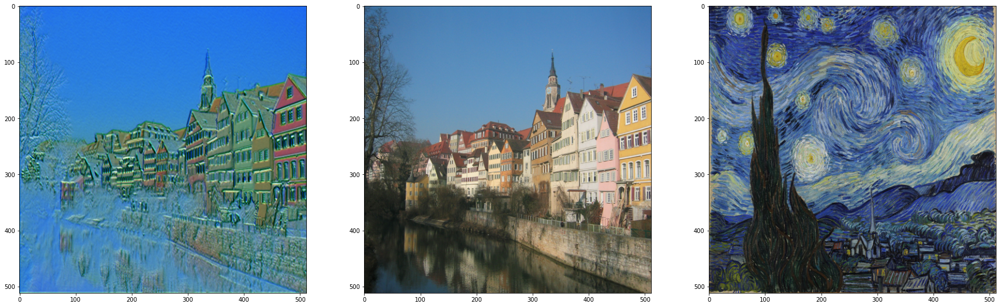

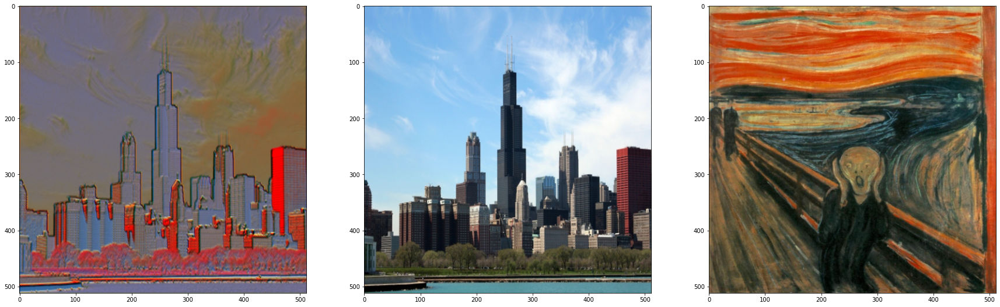

In [55]:
torch.cuda.empty_cache()
weights = [1, 0, 0, 0, 0, 0]
for i in range(5):

    contents, styles = dataset_test[np.random.randint(len(dataset_test)-1)]
    out = transfer_image(main_model, contents, styles, weights, True)

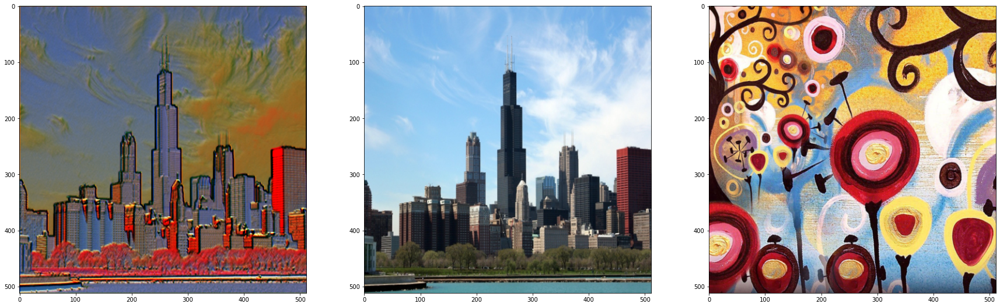

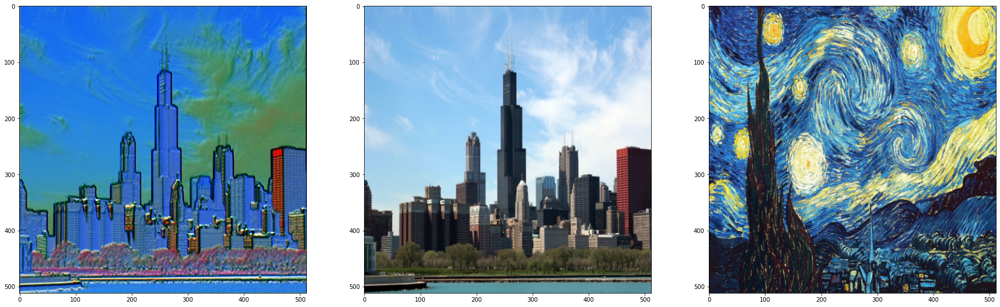

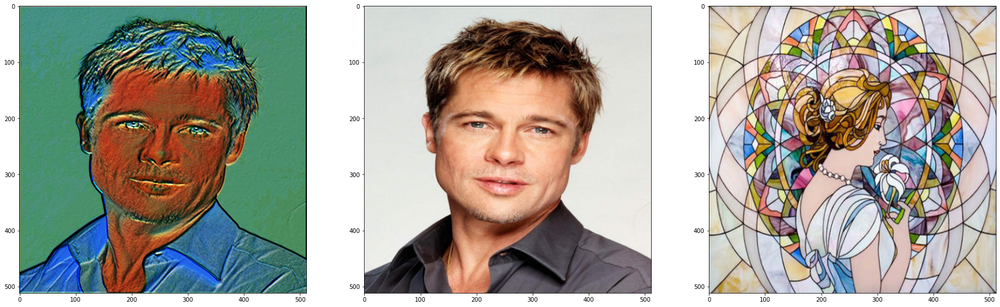

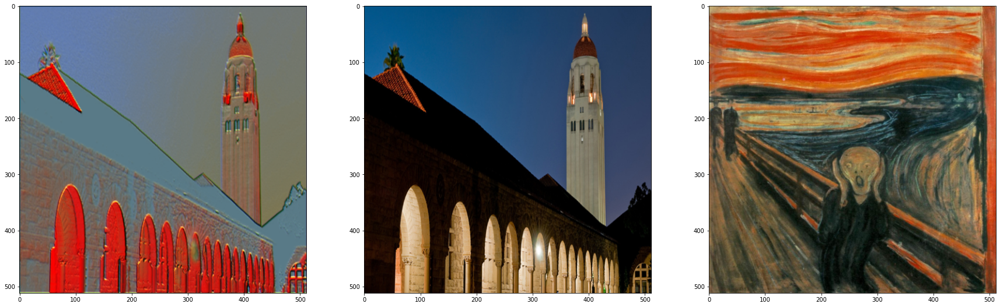

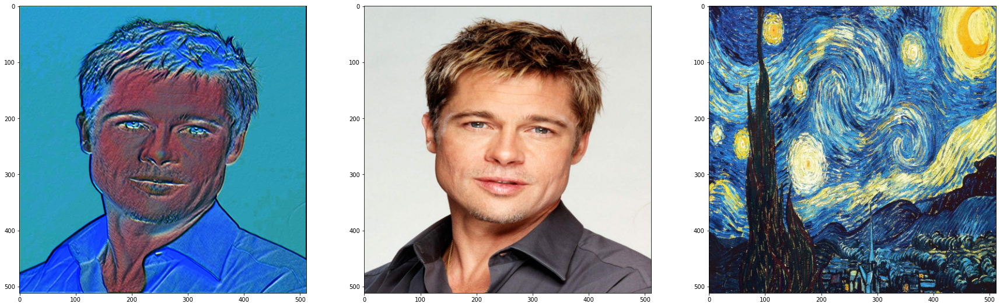

In [46]:
torch.cuda.empty_cache()

weights = [1, 1, 1, 1, 1, 1]
for i in range(5):
    contents, styles = dataset_test[np.random.randint(len(dataset_test)-1)]
    out = transfer_image(main_model, contents, styles, weights, True)

Увеличим размер кисти уменьшив силу сохранения контуров, т.е. ослабим влияние верхних слоёв энкодера.

In [ ]:
weights = [0.1, 0.1, 1, 0.75, 1, 1]
for i in range(5):
    contents, styles = dataset_test[np.random.randint(len(dataset_test)-1)]
    out = transfer_image(main_model, contents, styles, weights, True)

Для всевозможных значений весов сгенерируем стилизованные картинки.

In [ ]:
# save_results
import os
from skimage.io import imread, imsave
def apply_styles(model, test_dataset, save_directory, weights):

    if hasattr(model, 'weights'):
        model.weights = weights
    else:
        "Your model doesn't have controlling parameters!"
    
    os.makedirs(save_directory, exist_ok=True)

    num_images = len(test_dataset)
    weights_str = '_'.join([str(w) for w in weights])
    with torch.no_grad():
        for i in range(num_images):
            content, style = test_dataset[i]
            content_name, style_name = test_dataset.get_names(i)
            content_name = os.path.splitext(os.path.basename(content_name))[0]
            style_name = os.path.splitext(os.path.basename(style_name))[0]

            content, style = torch.unsqueeze(content, 0), torch.unsqueeze(style, 0)
            content, style = content.to(DEVICE), style.to(DEVICE)
            content, style = normalize(content), normalize(style)

            out = model(content, style)

            out_pil = transforms.ToPILImage()(out.detach()[0])

            imsave(
                os.path.join(save_directory, "{}_{}_{}.png".format(weights_str,
                                                                   content_name,
                                                                   style_name
                                                                   )),
                np.asarray(out_pil))

In [49]:
import copy 

def generate_all_possible(model, test_dataset, save_dir, weights, start_i=0, end_i=6, step=0.25):

    if not sum(weights):
        return 
    if start_i < end_i:
        generate_all_possible(model, test_dataset, save_dir,
                              weights, start_i+1, end_i, step)

    apply_styles(model, test_dataset, save_dir, weights)
   
    weights_copy = copy.deepcopy(weights)
    weights_copy[start_i] -= step
    if weights_copy[start_i] > 0:
        generate_all_possible(model, test_dataset, save_dir,
                            weights_copy, start_i, end_i, step)

In [ ]:
model = main_model
save_dir_name = "generated_UNet_vgg16_512"
weights = [1, 1, 1, 1, 1, 1]

generate_all_possible(model, dataset_test, save_dir_name, weights, 0, 4, 0.25)

Оценим скорость работы модели (Feedforward time).

In [ ]:
import time

start_time = time.time()
num_imgs = 10

for i in range(num_imgs):
    contents, styles = dataset_test[np.random.randint(len(dataset_test)-1)]
    out = transfer_image(main_model, contents, styles, weights, False)
end_time = time.time()

print("Work time is {}".format(end_time - start_time))

In [ ]:
#######CODE FOR GRADIENTS DEBUGGING.

In [ ]:
#debug tool for gradients value checking
from graphviz import Digraph
import torch
from torch.autograd import Variable, Function

def iter_graph(root, callback):
    queue = [root]
    seen = set()
    while queue:
        fn = queue.pop()
        if fn in seen:
            continue
        seen.add(fn)
        for next_fn, _ in fn.next_functions:
            if next_fn is not None:
                queue.append(next_fn)
        callback(fn)

def register_hooks(var):
    fn_dict = {}
    def hook_cb(fn):
        def register_grad(grad_input, grad_output):
            fn_dict[fn] = grad_input
        fn.register_hook(register_grad)
    iter_graph(var.grad_fn, hook_cb)

    def is_bad_grad(grad_output):
        if grad_output is None:
            return False
        return grad_output.isnan().any() or (grad_output.abs() >= 1e6).any()

    def make_dot():
        node_attr = dict(style='filled',
                        shape='box',
                        align='left',
                        fontsize='12',
                        ranksep='0.1',
                        height='0.2')
        dot = Digraph(node_attr=node_attr, graph_attr=dict(size="12,12"))

        def size_to_str(size):
            return '('+(', ').join(map(str, size))+')'

        def build_graph(fn):
            if hasattr(fn, 'variable'):  # if GradAccumulator
                u = fn.variable
                node_name = 'Variable\n ' + size_to_str(u.size())
                dot.node(str(id(u)), node_name, fillcolor='lightblue')
            else:
                assert fn in fn_dict, fn
                fillcolor = 'white'
                if any(is_bad_grad(gi) for gi in fn_dict[fn]):
                    fillcolor = 'red'
                dot.node(str(id(fn)), str(type(fn).__name__), fillcolor=fillcolor)
            for next_fn, _ in fn.next_functions:
                if next_fn is not None:
                    next_id = id(getattr(next_fn, 'variable', next_fn))
                    dot.edge(str(next_id), str(id(fn)))
        iter_graph(var.grad_fn, build_graph)

        return dot

    return make_dot

x = torch.randn(10, 10, requires_grad=True)
y = torch.randn(10, 10, requires_grad=True)

z = x / (y * 0)
z = z.sum() * 2
get_dot = register_hooks(z)
z.backward()
dot = get_dot()
dot # in Jupyter, you can just render the variable

####**Выводы**
В данном ноутбуке была продемонстирована идея использования сети U-Net c добавлением AdaIN преобразования на skip-connections.<br>
Основные преимущества данного подхода:
1. Достаточно быстрая скорость сходимоси, в сравнении с обычной реализацией
    Adain, Adain недостаточно для обучения 1000 шагов оптимизации (см результаты обучения - )
2. Данная модель спобона стилизовать контент под любой стиль 
3. Быстрая скорость feedforward шага ~ 10мс
4. Встроены пользовательские настроёки, меняющие размер кисти при стилизации

Недостатки данного подхода:
1. В энкодере использована достаточно "тяжелая" нейросеть vgg16, декодер также имеет достаточно много обучаемых параметров, общее кол-во обучаемых параметров около 31миллиона. Такое большое количество замедляет сам процесс обучения и не позволяет производить стилизацию на изображениях бОльшего разрешения. 
2. При обучении заметно, что градиенты плохо доходят до глубинных слоёв модели из-за чего в стилизованных изображениях мало и вовсе отсутсвуют высокоуровневые паттерны из стиля.


####**Дальнейшие шаги и улучшения**
1. Для борьбы с огромным количеством параметров стоит попробовать использовать более "лёгкие" нейросети, использование "лёгкого" resnet не решает данную проблему - качество стилизации оказывается хуже, чем при использовании vgg (результаты см. здесь), возможно, проблема в том что удаление BatchNorm слоёв сильно ухудшае данную модель. Возможно стоит попробовать с сетям чуть большим количеством обучаемых параметров - GoogleLeNet, Inception и другие.

2. Для борьбы с малыми градиентами на глубинных слоях -  здесь, возможно, стоит использовать skip-connections не только между энкодером - декодером, но и внутри самого энкодера и декодера. (Как это сдеално в ResNet).
